# Package importation

In [1]:
import os 

%load_ext autoreload
%autoreload 2

os.chdir("/Users/antoineluciano/Documents/Recherche/permABC_new/permABC")


from vanilla import abc_vanilla, perm_abc_vanilla
from smc import abc_smc, perm_abc_smc
from over_sampling import perm_abc_smc_os
from under_matching import perm_abc_smc_um  
from kernels import KernelTruncatedRW
from distances import optimal_index_distance
from models.SIR import SIRWithKnownInit, SIRWithUnknownInit
from jax import random
import numpy as np
import jax.numpy as jnp
from scipy.stats import invgamma
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd 

In [2]:
def fit_data(mod, gen, y_obs, thetas, names, size = 100):
    K = y_obs.shape[0]

    index_random = np.random.choice(np.arange(1000),size=min(size, len(thetas)), replace = False)
    zs = mod.data_generator(gen, thetas[index_random])
    for k in range(K):
        for i in range(len(index_random)):
            plt.plot(zs[i][k], color = "blue", alpha = .1)
        plt.title(str(k)+": "+names[k])
        plt.plot(y_obs[k],label="Observed",color = "red")
        if k==0: plt.legend()
        plt.show()

# Data importation

## Population and name

In [3]:
df_pop = pd.read_csv("./datas/donnees_departements.csv", sep = ";")

dep_pop = {df_pop.loc[i]["CODDEP"]:df_pop.loc[i]["PTOT"] for i in range(df_pop.shape[0])}
dep_name = {df_pop.loc[i]["CODDEP"]:df_pop.loc[i]["DEP"] for i in range(df_pop.shape[0])}

reg = np.unique(df_pop["CODREG"])
reg_pop = {}
reg_name = {}
for r in reg: 
    reg_pop[r] = df_pop[df_pop["CODREG"]==r]["PTOT"].sum()
    reg_name[r] = df_pop[df_pop["CODREG"]==r]["REG"].iloc[0]

dep_reg = {df_pop.loc[i]["CODDEP"]:df_pop.loc[i]["CODREG"] for i in range(df_pop.shape[0])}

## Data by departement

In [4]:
df_dep = pd.read_csv("./datas/data-dep.csv",sep=";")
df_dep=df_dep.iloc[np.where(df_dep.loc[:]["sexe"]==0)]
df_dep = df_dep[~df_dep['dep'].isin(["971", "972", "973", "974", "976", "978","2A","2B"])]


date=np.unique(np.array(pd.to_datetime(df_dep.iloc[:]["jour"])))
df_dep["reg"] = ""
df_dep["pop"] = ""

dep_list = np.unique(df_dep["dep"])
for d in dep_list:  
    df_dep.loc[df_dep["dep"]==d,"reg"] = dep_reg[d]
    df_dep.loc[df_dep["dep"]==d,"pop"] = dep_pop[d]
    
I_obs_dep = np.array([df_dep.loc[df_dep["dep"]==d]["hosp"].rolling(window=7).mean()[6:]/dep_pop[d]*100000*15 for d in dep_list])

date = date[6:]
K_dep = I_obs_dep.shape[0]
I_obs_dep.shape

(94, 1103)

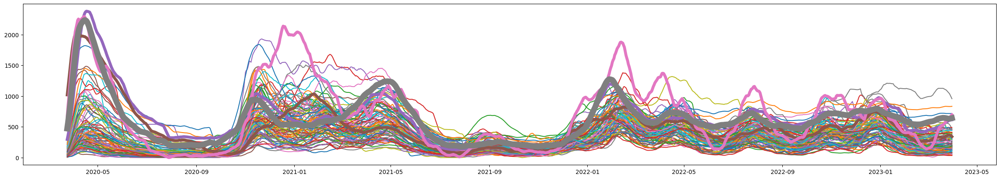

In [5]:
plt.figure(figsize=(30,5))
for i in range(I_obs_dep.shape[0]):
    plt.plot(date,I_obs_dep[i], label = dep_name[dep_list[i]])
plt.plot(date, I_obs_dep[92],lw=5)
plt.plot(date, I_obs_dep[66],lw=5)
plt.plot(date, I_obs_dep[88],lw=5)
plt.plot(date, I_obs_dep[73],lw=10)


plt.show()

## Data by region

In [6]:
df_reg = df_dep.groupby(['jour', 'reg']).sum().reset_index()
reg_list = np.unique(df_reg["reg"])
I_obs_reg = np.array([df_reg.loc[df_reg["reg"]==r]["hosp"].rolling(window=7).mean()[6:]/reg_pop[r]*100000*15 for r in reg_list])
K_reg = I_obs_reg.shape[0]
I_obs_reg.shape

(12, 1103)

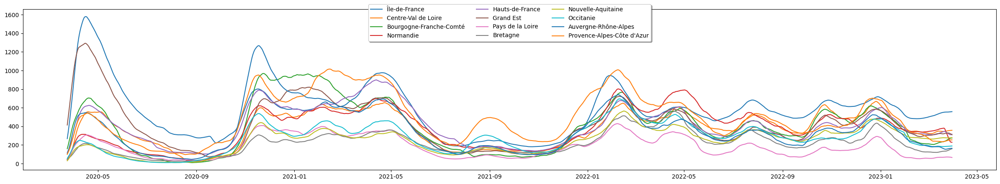

In [7]:
plt.figure(figsize=(30,5))
for i in range(I_obs_reg.shape[0]):
    plt.plot(date,I_obs_reg[i], label = reg_name[reg_list[i]])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.05),
          ncol=3, fancybox=True, shadow=True)
plt.show()

## Data at national scale

In [8]:
df_fr = df_dep.groupby(['jour']).sum().reset_index()

K_fr = 1
I_obs_fr = np.array(df_fr["hosp"].rolling(window=7).mean()[6:]/df_fr["pop"][0]*100000*15)

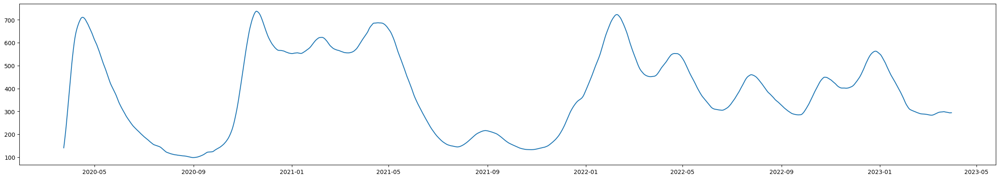

In [9]:
plt.figure(figsize=(30,5))
plt.plot(date,I_obs_fr, label = "France")


## Focus on the first wave

From 2020-03-24T00:00:00.000000000 to 2020-07-21T00:00:00.000000000


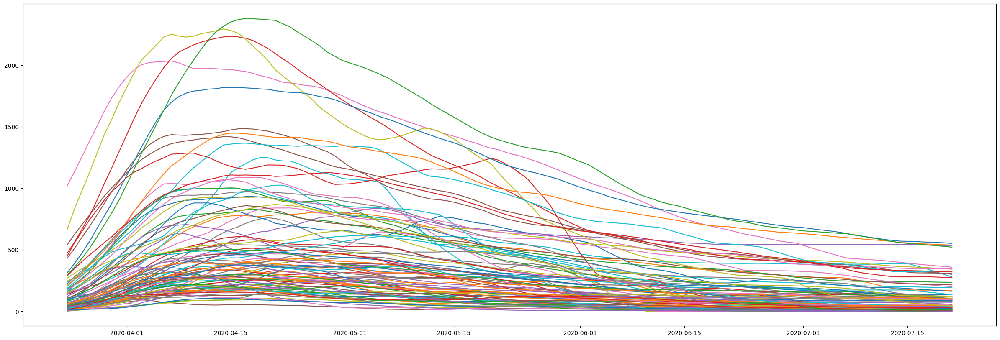

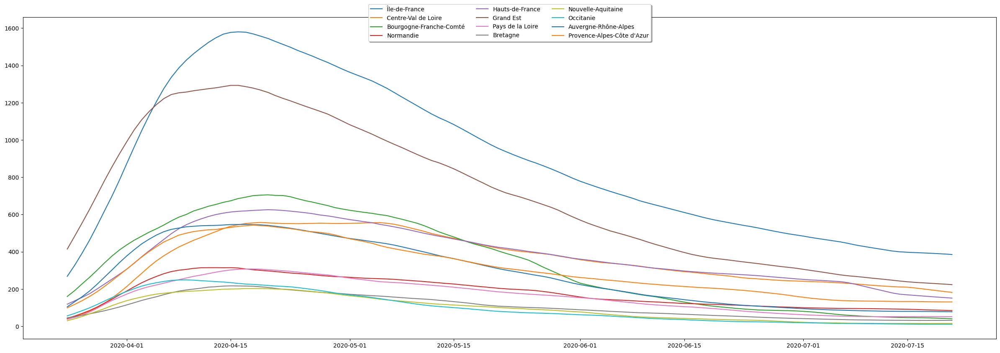

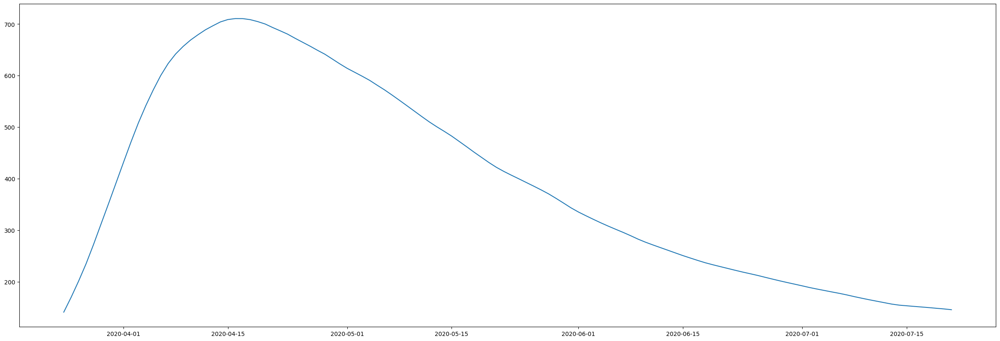

In [10]:
n = 120
date_V1 = date[:n]
print("From {} to {}".format(date_V1[0],date_V1[-1]))
I_obs_dep_V1 = I_obs_dep[:,:n]
I_obs_reg_V1 = I_obs_reg[:,:n]
I_obs_fr_V1 = I_obs_fr[:n]

plt.figure(figsize=(30,10))
for i in range(I_obs_dep_V1.shape[0]):
    plt.plot(date_V1,I_obs_dep_V1[i], label = dep_name[dep_list[i]])
plt.show()

plt.figure(figsize=(30,10))
for i in range(I_obs_reg_V1.shape[0]):
    plt.plot(date_V1,I_obs_reg_V1[i], label = reg_name[reg_list[i]])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.05),
          ncol=3, fancybox=True, shadow=True)
plt.show()

plt.figure(figsize=(30,10))
plt.plot(date_V1,I_obs_fr_V1, label = "France")
plt.show()


# ABC Inference

## National scale

In [1]:
high_I, high_R, high_beta, high_r0 = 1000, 1000, 5, 5
n_pop = 100000
mod_fr = SIRWithUnknownInit(K_fr, n_obs = n, n_pop = n_pop, high_I = high_I, high_R = high_R, high_beta = high_beta, high_r0 = high_r0)

NameError: name 'SIRWithUnknownInit' is not defined

### Vanilla

In [ ]:
def ABC_table(key, model, y_obs, n_sim):
    key, key_theta, key_sim = random.split(key, 3)
    thetas = model.prior_generator(key_theta, n_sim)
    zs = model.data_generator(key_sim, thetas)
    distances = model.distance(zs, y_obs)
    print(distances.shape)
    return zs, thetas, distances

def permABC_table(key, model, y_obs, n_sim):
    key, key_theta, key_sim = random.split(key, 3)
    thetas = model.prior_generator(key_theta, n_sim)
    zs = model.data_generator(key_sim, thetas)
    dists, zs_index, _ = optimal_index_distance(zs, y_obs, model)
    zs = zs[np.arange(n_sim)[:,None],zs_index]
    thetas = thetas.apply_permutation(zs_index)
    return zs, thetas, dists
 

In [ ]:
I_obs_fr_V1.shape

(120,)

In [ ]:
thetas_van_fr


Theta(loc=array([[[4.29151377e+01, 1.43089775e+02, 1.07519712e+00]],

       [[4.33830716e+02, 4.14293127e+02, 4.80505388e+00]],

       [[5.88462198e+02, 9.60228959e+02, 2.19665362e-01]],

       ...,

       [[7.69602383e+02, 9.21507871e+02, 3.30158239e+00]],

       [[8.69767524e+02, 3.80136869e+02, 3.06137465e+00]],

       [[6.46151340e+02, 8.83267894e+02, 1.79044525e+00]]]), glob=array([[3.83783057],
       [0.29451364],
       [4.32708392],
       ...,
       [1.98187011],
       [2.36792002],
       [0.00530942]]))

In [ ]:
i = 2
zs_van_fr[i,0,0], thetas_van_fr.loc[i,0,0]

(Array(685.85163617, dtype=float64), 588.4621984396974)

In [ ]:
np.any(np.isnan(zs_van_fr))

True

In [ ]:
from jax import random 
N_van_fr = 1000000
key = random.PRNGKey(0)
key, key_abc = random.split(key)
thetas_van_fr = mod_fr.prior_generator(key_abc, N_van_fr)
print("AFTER: loc.shape = ", thetas_van_fr.loc.shape, "glob.shape = ", thetas_van_fr.glob.shape)
key, key_sim = random.split(key_abc)
zs_van_fr = mod_fr.data_generator(key_sim, thetas_van_fr)
print("zs.shape = ", zs_van_fr.shape)
dists_van_fr = mod_fr.distance(zs_van_fr, I_obs_fr_V1[None, None, :])
dists_perm_van_fr, ys_index_van_fr, zs_index_van_fr, _ = optimal_index_distance(mod_fr, zs_van_fr, I_obs_fr_V1[None, None, :])
epsilon_van_fr = np.quantile(dists_van_fr, 0.001)
zs_van_fr = zs_van_fr[dists_van_fr < epsilon_van_ fr]
thetas_van_fr = thetas_van_fr[dists_van_fr < epsilon_fr]
print("epsilon = ", epsilon_van_fr)
epsilon_perm_van_fr = np.quantile(dists_perm_van_fr, 0.001)
print("epsilon_perm = ", epsilon_perm_van_fr)
zs_perm_van_fr = zs_van_fr[np.arange(N_van_fr)[:,None],zs_index_van_fr]
thetas_perm_van_fr = thetas_van_fr.apply_permutation(zs_index_van_fr)

Loc shape: (1000000, 1, 3)
Loc shape: (1000000, 1, 3)
Glob shape: (1000000, 1)
Glob shape: (1000000, 1)
AFTER: loc.shape =  (1000000, 1, 3) glob.shape =  (1000000, 1)
zs.shape =  (1000000, 1, 120)
epsilon =  3781467.0777103147


In [ ]:
import jax
import jax.numpy as jnp
from jax import jit, vmap



In [ ]:
key = random.PRNGKey(0)
key, key_thetas = random.split(key)
thetas = mod_fr.prior_generator(key_thetas, 1000)
thetas
I0 = thetas.loc[:, :, 0]
R0 = thetas.loc[:, :, 1]
betas = thetas.loc[:, :, 2]
gammas = betas / thetas.glob[:, :] 
n_obs = n
S0 = n_pop - I0 - R0
print("S0 shape: {} I0 shape: {} R0 shape: {} betas shape: {} gammas shape: {}".format(S0.shape, I0.shape, R0.shape, betas.shape, gammas.shape))

I_trajectories = simulate_sir_jit(S0, I0, R0, betas, gammas, n_pop, n_obs)

Loc shape: (1000, 1, 3)
Loc shape: (1000, 1, 3)
Glob shape: (1000, 1)
Glob shape: (1000, 1)
S0 shape: (1000, 1) I0 shape: (1000, 1) R0 shape: (1000, 1) betas shape: (1000, 1) gammas shape: (1000, 1)


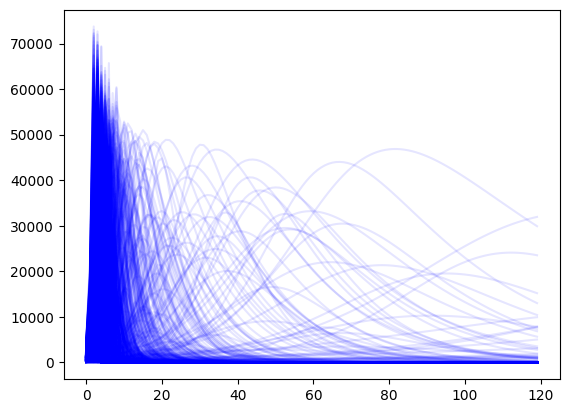

In [ ]:
for i in range(1000):
    plt.plot(I_trajectories[i,0,:], color = "blue", alpha = .1)

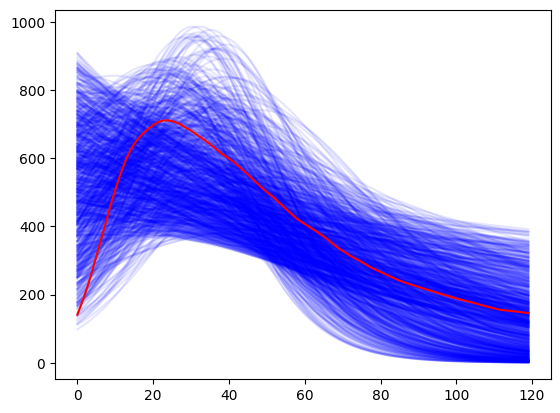

In [ ]:
for z in zs_van_fr[:1000]:
    plt.plot(z[0], color = "blue", alpha = .1)
plt.plot(I_obs_fr_V1, color = "red")
plt.show()

In [ ]:
def display(mod,thetas, names, size= 5, true_theta = [], bw = "scott", prior = False, K_prime = 0):
    if K_prime==0: ks = range(mod.K)
    else: ks = np.random.choice(range(mod.K),K_prime,replace = False)
    if len(ks)>1:f, ax = plt.subplots(mod.dim_loc, len(ks), figsize = (len(ks)*size, mod.dim_loc*size))
    else: f, ax = plt.subplots(mod.dim_loc, figsize = (size,mod.dim_loc*size))
    
    if prior: 
        law_prior = mod.prior_law()
    for j in range(mod.dim_loc):
        
        
        for k,k_prime in enumerate(ks):
            if mod.dim_loc==1 and len(ks)>1: axx = ax[k]
            elif mod.dim_loc>1 and len(ks)>1: axx = ax[j,k]
            elif mod.dim_loc>1 and len(ks)==1: axx = ax[j]
        
            else: axx = ax
            
            
            for theta,name in zip(thetas,names):
                sns.kdeplot(theta.loc[:,k_prime,j],ax = axx, label = name, bw_method = bw)
            if len(true_theta)>0: axx.axvline(true_theta.loc[0,k_prime,j], linestyle = "dashed", color = "red",label = "true value")
            if prior: 
                law_prior_loc = law_prior.loc[j]
                x = np.linspace(np.min(theta.loc[:,k_prime,j].reshape(-1)),np.max(theta.loc[:,k_prime,j].reshape(-1)), 100)
                # ax[j,k].plot(x, law_prior_loc.pdf(x), label = "prior", linestyle = "dotted", color = "black")
                axx.axhline(1/(mod.support_par_loc[j,1]-mod.support_par_loc[j,0]), color = "black", alpha = .5)
            if j+k==0: axx.legend()
            axx.set_title(mod.loc_name[j]+str(k_prime)+'}$')
    plt.plot()

    f,ax = plt.subplots(1,mod.dim_glob, figsize = (size*mod.dim_glob,size))

    for j in range(mod.dim_glob):
        if mod.dim_glob==1:
            axx = ax
        else: 
            axx = ax[j]
        for theta, name in zip(thetas, names):
            sns.kdeplot(theta.glob[:,j], ax = axx, label = name+" {:.2%}".format(len(np.unique(theta.glob,axis=0))/len(theta)), bw_method = bw)
            if prior:
                law_prior_glob = law_prior.glob[j]
                x = np.linspace(np.min(theta.glob[:,j].reshape(-1)),np.max(theta.glob[:,j].reshape(-1)), 100)
                # axx.plot(x, law_prior_glob.pdf(x), label = "prior", linestyle = "dotted", color = "black")
                axx.axhline(1/(mod.support_par_glob[j,1]-mod.support_par_glob[j,0]), color = "black", alpha = .5)
        if len(true_theta)>0:
            axx.axvline(np.array(true_theta.glob)[0,j],linestyle = "dashed", color = "red",label = "true value")
        axx.set_title(mod.glob_name[j])
    axx.legend()
    plt.show()
    

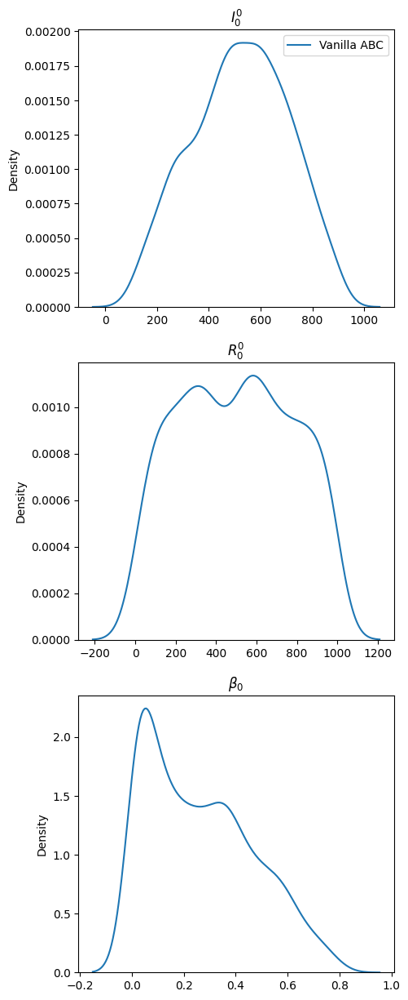

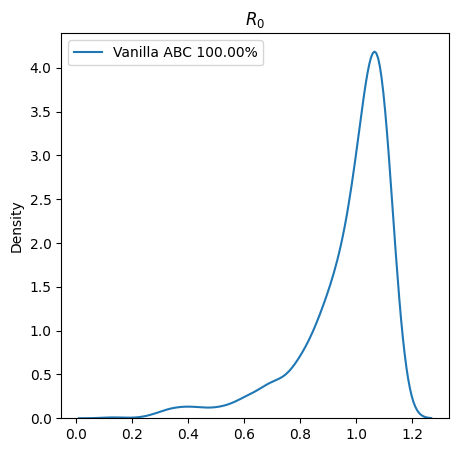

In [ ]:
display(mod_fr, [thetas_van_fr], ["Vanilla ABC"])

### SMC 

In [ ]:
key, key_smc = random.split(key)
N = 1000
alpha = .95
smc_fr = abc_smc(key = key_smc, model = mod_fr, y_obs = I_obs_fr_V1[None, None, :], n_particles= N, kernel = KernelTruncatedRW, verbose = 1, epsilon_target = 0., update_weights_distance= False)
thetas_smc_fr = smc_fr["Thetas"][-1]
zs_smc_fr = smc_fr["Zs"][-1]

Loc shape: (1000, 1, 3)
Loc shape: (1000, 1, 3)
Glob shape: (1000, 1)
Glob shape: (1000, 1)
Iteration 0: Epsilon = inf, ESS = 1000 Acc. rate = 100% Numb. unique particles = 1000
Iteration 1: Espilon = 15432278502.4728, ESS = 950 Acc. rate = 79.47% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%
NUMBER OF SIMULATIONS 1950/inf

Iteration 2: Espilon = 10084310924.9565, ESS = 902 Acc. rate = 79.05% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%
NUMBER OF SIMULATIONS 2852/inf

Iteration 3: Espilon = 7405887448.9777, ESS = 856 Acc. rate = 77.69% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%
NUMBER OF SIMULATIONS 3708/inf

Iteration 4: Espilon = 5995406148.9661, ESS = 813 Acc. rate = 72.20% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness ra

KeyboardInterrupt: 

In [ ]:
for zs in zs_smc_fr[:1000]:
    plt.plot(zs[0], color = "blue", alpha = .1)
plt.plot(I_obs_fr_V1, color = "red")
plt.show()


NameError: name 'zs_smc_fr' is not defined

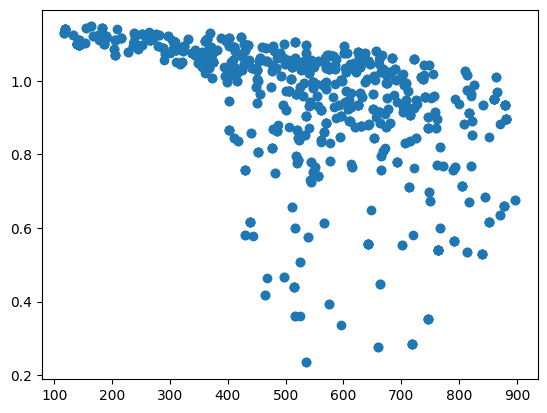

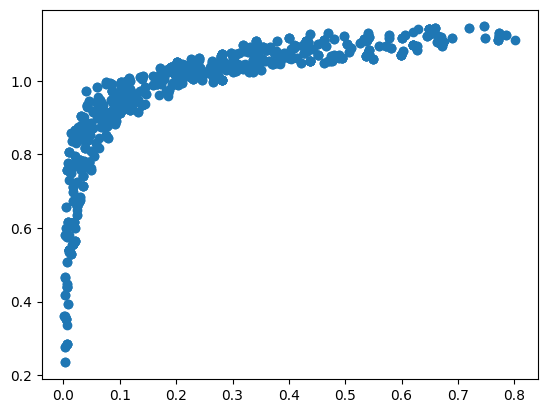

In [ ]:
plt.scatter(thetas_smc_fr.loc[:,0,0], thetas_smc_fr.glob[:,0])
plt.show()
plt.scatter(thetas_smc_fr.loc[:,0,2], thetas_smc_fr.glob[:,0])

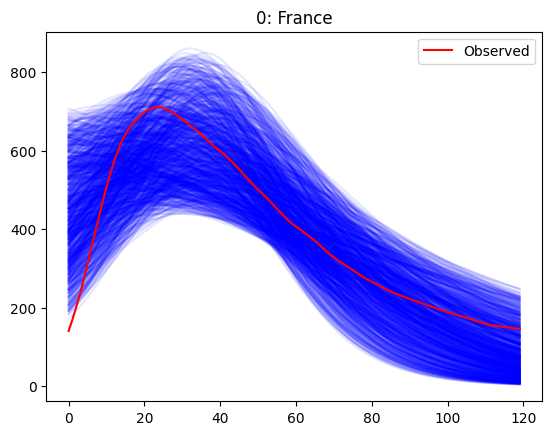

In [ ]:
fit_data(mod_fr, gen, I_obs_fr_V1[np.newaxis,:], thetas_smc_fr, ["France"], size = 1000)

## At the regional scale

### With independant Vanilla

In [ ]:
T=100000
abcp=[]
from tqdm.notebook import tqdm
mod_i = SIRWithUnknownInit(1, n_obs = n, n_pop = n_pop, high_I = high_I, high_R = high_R, high_beta = high_beta, high_r0 = high_r0)
for i in tqdm(range(I_obs_reg_V1.shape[0])): 
    key, key_abc = random.split(key)
    y_obs_i = I_obs_reg_V1[i][np.newaxis,np.newaxis,:]
    

NameError: name 'n_pop' is not defined

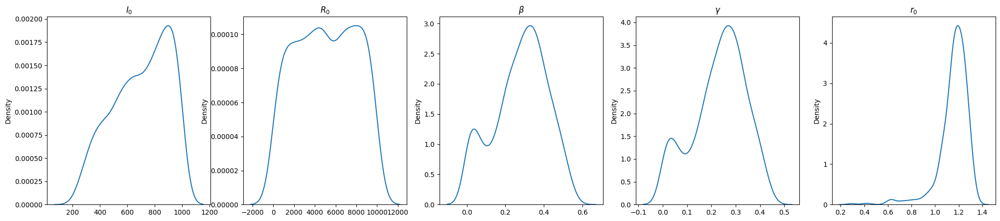

0: I_0 = 702.3615431140018 R_0 = 5088.4531699723075 Beta = 0.2800043003857178 Gamma = 0.2331925179299413 R0 = 1.1574943205495525 Epsilon = 36.43474984490693


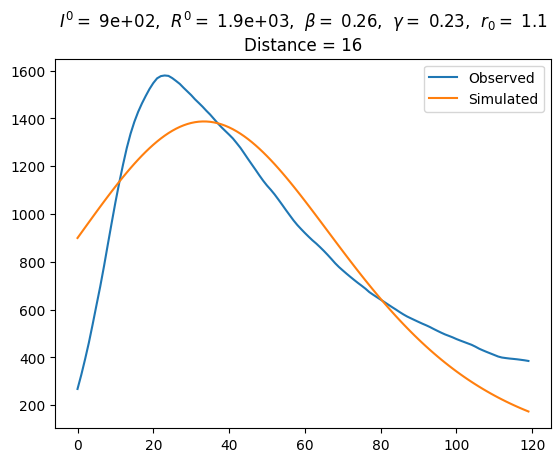

Epsilon =  36.43474984490693 Distance =  [16.29061847] [16.29061847]
4.822468766298273


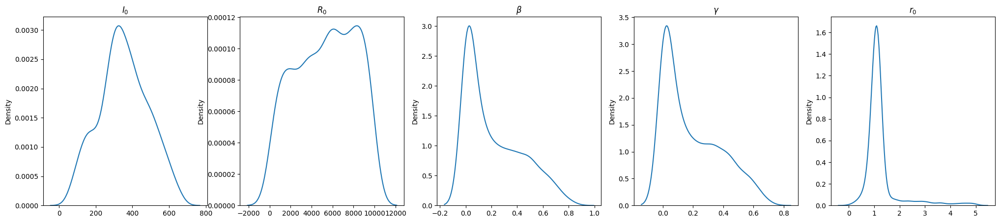

1: I_0 = 353.03768361426273 R_0 = 5346.5538220262515 Beta = 0.2155812126537197 Gamma = 0.19153449202282927 R0 = 1.2564092391075392 Epsilon = 15.3657319176502


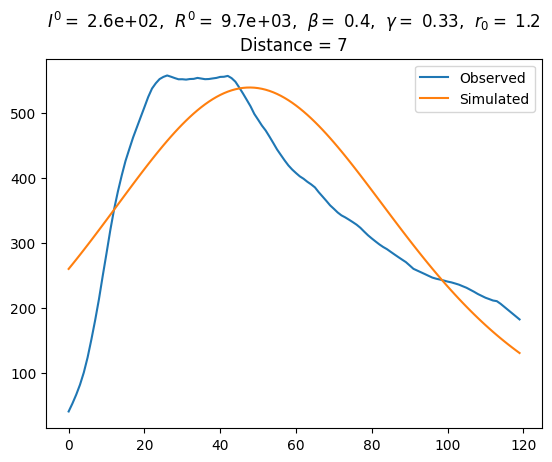

Epsilon =  15.3657319176502 Distance =  [7.37808492] [7.37808492]
6.107021909556117


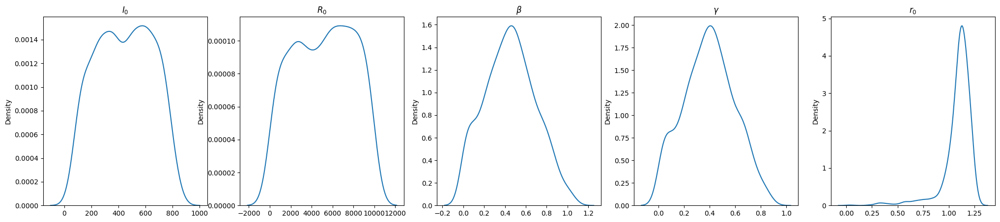

2: I_0 = 444.9011441018339 R_0 = 5132.58303059174 Beta = 0.4502253466192061 Gamma = 0.39556101615739486 R0 = 1.0870225360912227 Epsilon = 15.772706090160659


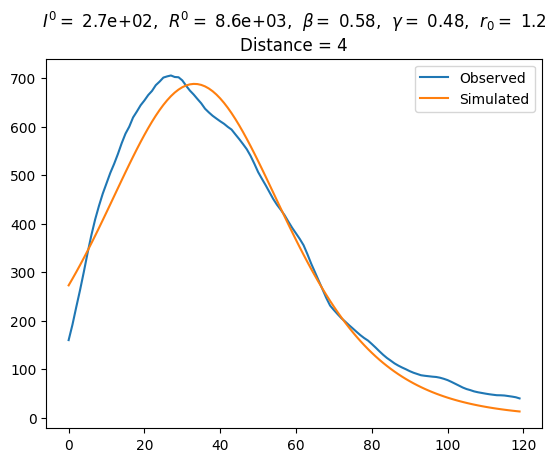

Epsilon =  15.772706090160659 Distance =  [3.50687932] [3.50687932]
1.5423743671168553


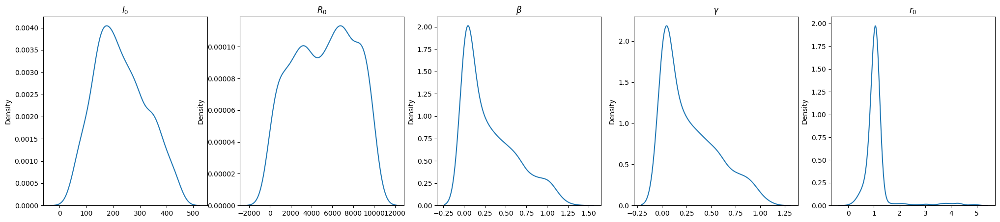

3: I_0 = 228.5903044020926 R_0 = 5189.608753888596 Beta = 0.31495423136604916 Gamma = 0.2895776041166264 R0 = 1.1194060237422774 Epsilon = 8.703296248298097


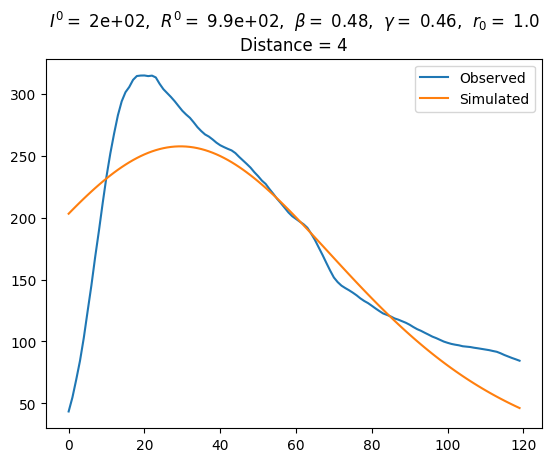

Epsilon =  8.703296248298097 Distance =  [3.68681581] [3.68681581]
5.897877445788943


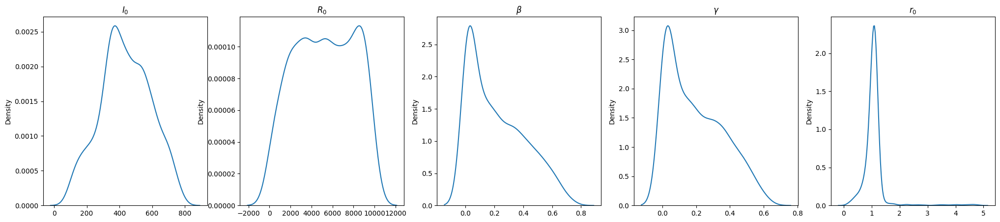

4: I_0 = 437.2480726050079 R_0 = 5238.349556155115 Beta = 0.21883023167622104 Gamma = 0.19676358153311993 R0 = 1.0856961444451234 Epsilon = 15.169521329521283


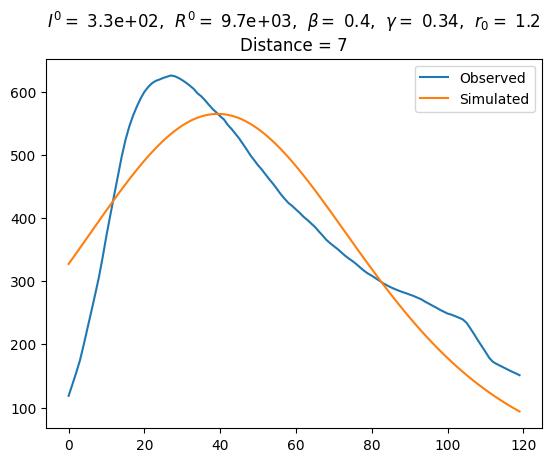

Epsilon =  15.169521329521283 Distance =  [6.5848122] [6.5848122]
4.282610235333959


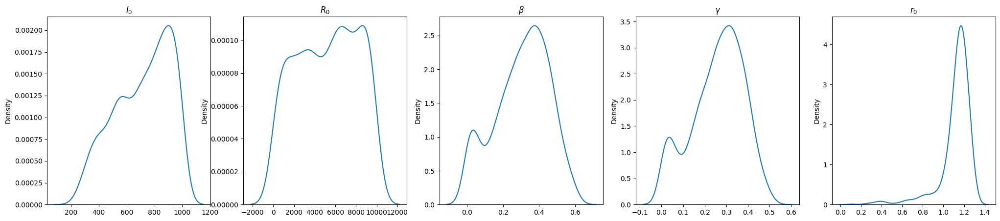

5: I_0 = 716.0556086570125 R_0 = 5214.92727370966 Beta = 0.30525991346600817 Gamma = 0.26029690480118356 R0 = 1.120512755985656 Epsilon = 27.497677502831145


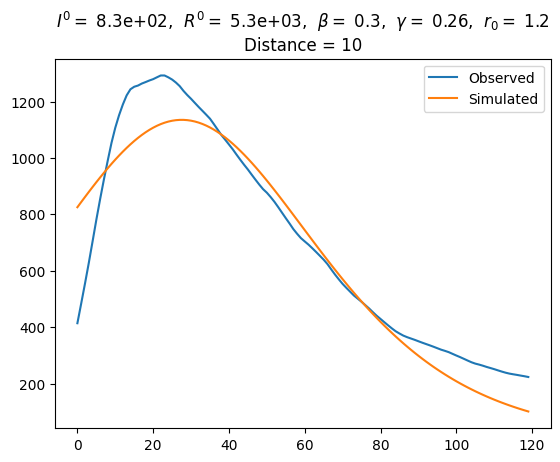

Epsilon =  27.497677502831145 Distance =  [9.81575649] [9.81575649]
2.763378084200009


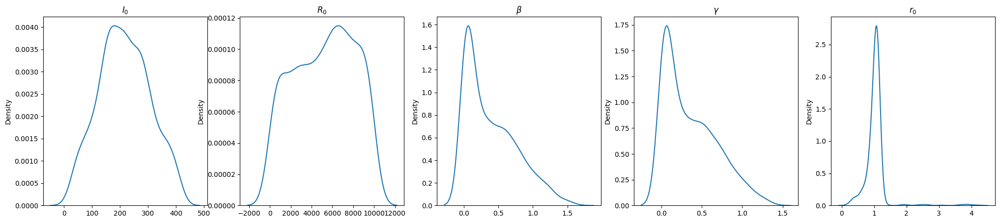

6: I_0 = 216.30126150635942 R_0 = 5224.868662235852 Beta = 0.39644560757564373 Gamma = 0.3629525455745578 R0 = 1.0365446381313774 Epsilon = 8.478870149853325


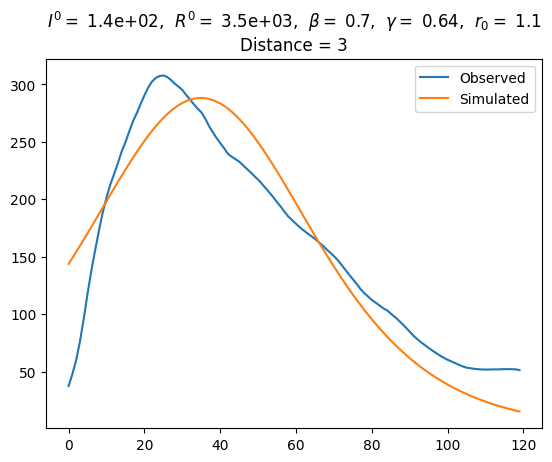

Epsilon =  8.478870149853325 Distance =  [2.85696501] [2.85696501]
4.474113245080598


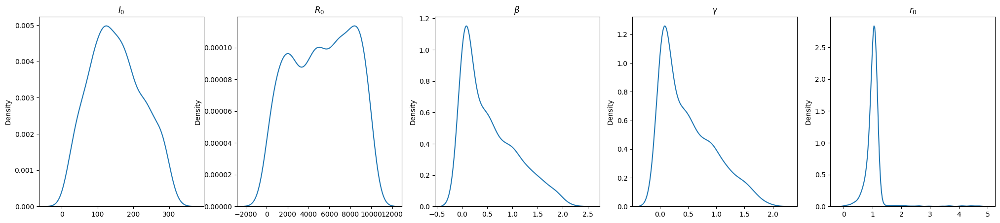

7: I_0 = 152.53500983868145 R_0 = 5292.765385754784 Beta = 0.5483387518760722 Gamma = 0.5056080719608156 R0 = 1.0429114239335477 Epsilon = 6.15275730354043


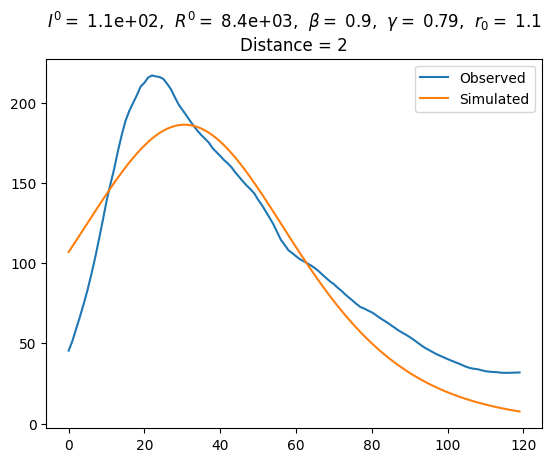

Epsilon =  6.15275730354043 Distance =  [2.02135774] [2.02135774]
5.13365076623717


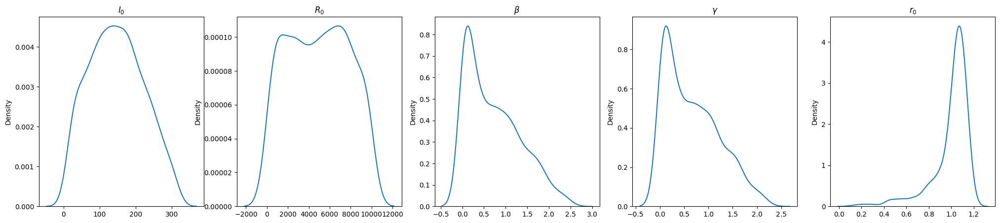

8: I_0 = 147.04877475745994 R_0 = 4911.298678241948 Beta = 0.7253232071023525 Gamma = 0.6689837754365142 R0 = 0.9962104082001696 Epsilon = 5.81395248328698


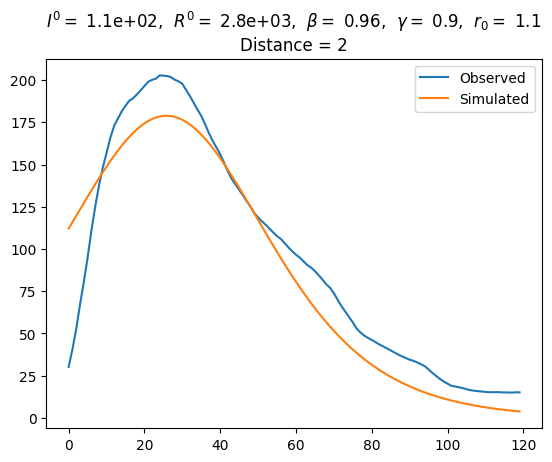

Epsilon =  5.81395248328698 Distance =  [1.84943166] [1.84943166]
5.421011244636177


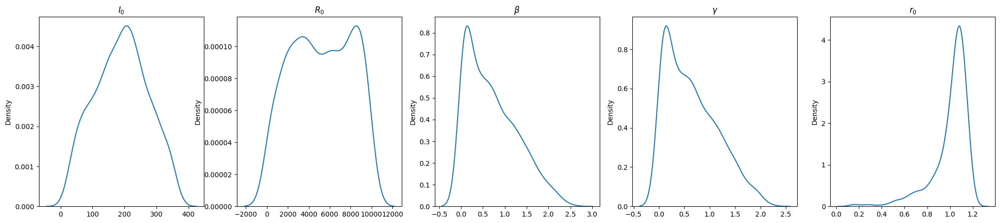

9: I_0 = 190.20642931723162 R_0 = 5212.18182503327 Beta = 0.7078322354194889 Gamma = 0.6510102192840727 R0 = 1.0045992697469095 Epsilon = 5.910073610975234


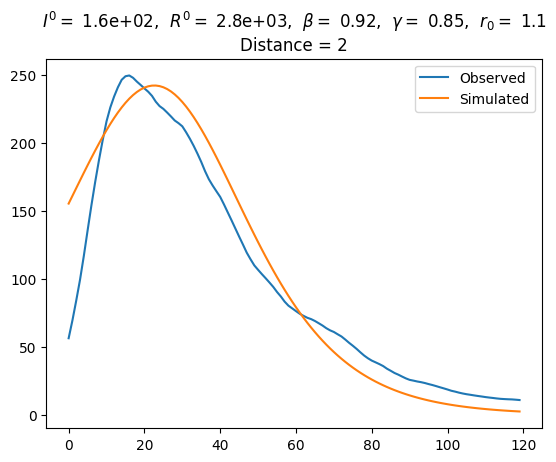

Epsilon =  5.910073610975234 Distance =  [2.09144098] [2.09144098]
6.170955921039272


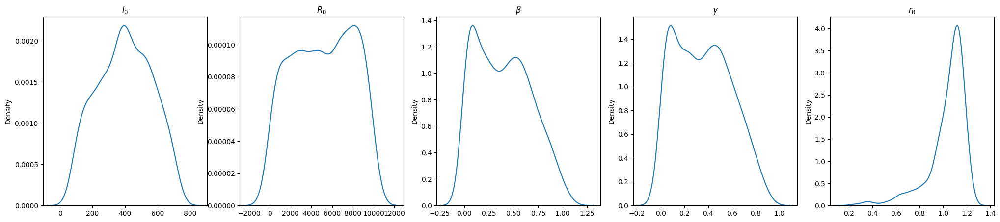

10: I_0 = 398.65384477230157 R_0 = 5115.341483493837 Beta = 0.39924627844844107 Gamma = 0.3584280251758913 R0 = 1.036791320780072 Epsilon = 12.859615272648718


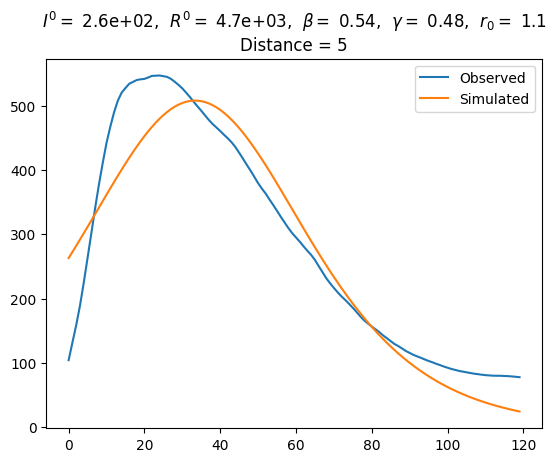

Epsilon =  12.859615272648718 Distance =  [4.76273468] [4.76273468]
4.009092279098145


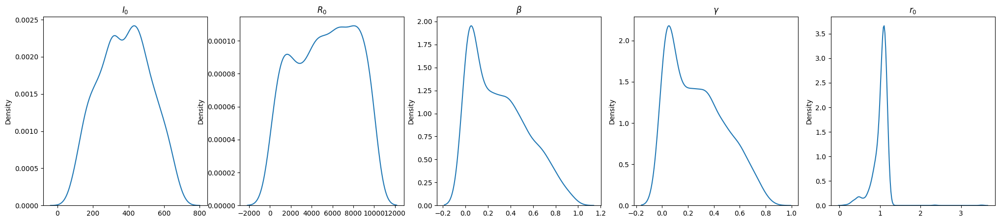

11: I_0 = 378.4639056663538 R_0 = 5276.494162161459 Beta = 0.3030058249760915 Gamma = 0.27370145569023613 R0 = 1.0168134385738228 Epsilon = 13.013171261790497


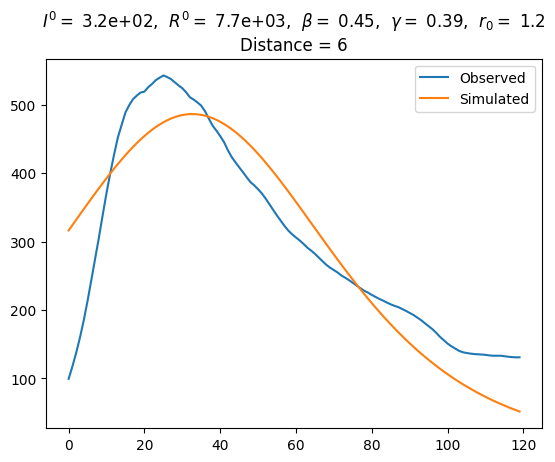

Epsilon =  13.013171261790497 Distance =  [5.77999231] [5.77999231]
5.2090363845770895


In [ ]:
Beta,Gamma = [],[]
Epsilon = []

for i in range(I_obs_reg_V1.shape[0]):
    
    distances = abcp[i][2]
    thetas = abcp[i][0][np.argsort(distances)[:1000]]
    distances_ok = np.sort(distances)[:1000]
    epsilon = np.sort(distances)[1000]
    Epsilon.append(epsilon)
    
    I0s = thetas.loc[:,0,0].reshape(-1)
    R0s = thetas.loc[:,0,1].reshape(-1)
    betas = thetas.loc[:,0,2].reshape(-1)
    r0s = thetas.glob[:,0].reshape(-1)
    gammas = betas/r0s

    f,ax = plt.subplots(1,5,figsize=(25,5))
    sns.kdeplot(I0s,ax=ax[0])
    ax[0].set_title("$I_0$")
    sns.kdeplot(R0s,ax=ax[1])
    ax[1].set_title("$R_0$")
    sns.kdeplot(betas,ax=ax[2])
    ax[2].set_title("$\\beta$")
    sns.kdeplot(gammas,ax=ax[3])
    ax[3].set_title("$\gamma$")
    sns.kdeplot(r0s,ax=ax[4])
    ax[4].set_title("$r_0$")
    plt.show()
    
    distances = abcp[i][2]
    print("{}: I_0 = {} R_0 = {} Beta = {} Gamma = {} R0 = {} Epsilon = {}".format(i,I0s.mean(), R0s.mean(), betas.mean(), gammas.mean(), r0s.mean(),epsilon))
    Beta.append(betas.mean())
    Gamma.append(gammas.mean())
    index_random = [0]
    
    theta_i = Theta(loc = np.array([I0s[index_random], R0s[index_random], betas[index_random]])[np.newaxis,np.newaxis,:],glob= np.array([[r0s[index_random]]]))

    plt.plot(I_obs_reg_V1[i], label = "Observed")
    I_sim = mod_i.data_gen(gen,theta_i)
    plt.plot(I_sim[0,0], label = "Simulated")
    plt.title("$I^0 =$ {:.2},  $R^0 =$ {:.2},  $\\beta =$ {:.2},  $\gamma =$ {:.2},  $r_0 =$ {:.2}\nDistance = {:0.0f}".format(I0s[index_random][0], R0s[index_random][0], betas[index_random][0], gammas[index_random][0], r0s[index_random][0], distances_ok[index_random][0]))
    plt.legend()
    plt.show()
    obs_distance = distance_arr(I_sim, I_obs_reg_V1[i][np.newaxis,np.newaxis,:])
    print("Epsilon = ", epsilon, "Distance = ", obs_distance, distances_ok[index_random])
    zs = I_sim
    y_obs = I_obs_reg_V1[i][np.newaxis,np.newaxis,:]
    print((((zs[0]-y_obs[0])/y_obs.sum(axis=2)*y_obs.shape[2])**2).sum())

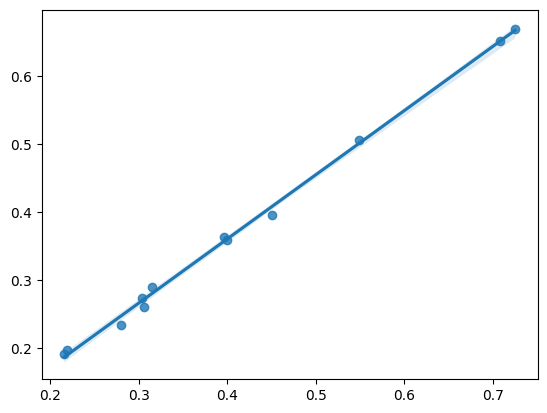

In [ ]:

sns.regplot(x = Beta, y = Gamma)
plt.show()

### Hierarchical model

In [ ]:
weights_region = [reg_pop[r] for r in reg_list]

In [ ]:
mod_reg = SIRWithUnknownInit(K = K_reg, n_obs = 120, n_pop=100000, high_I = 1000, high_R = 10000, high_beta=5, high_r0= 5, weights_distance = weights_region)

y_obs_reg = np.array(I_obs_reg_V1)[np.newaxis,:]

#### Vanilla

In [ ]:
T = 100000  
key, key_abc = random.split(key)
thetas_van_reg = mod_reg.prior_generator(key_abc, T)
key, key_sim = random.split(key_abc)
zs_van_reg = mod_reg.data_generator(key_sim, thetas_van_reg)
dists_van_reg = mod_reg.distance(zs_van_reg, y_obs_reg)
dists_perm_van_reg, ys_index_van_reg, zs_index_van_reg, _ = optimal_index_distance(mod_reg, zs_van_reg, y_obs_reg)
epsilon_van_reg = np.quantile(dists_van_reg, 0.01)
epsilon_perm_van_reg = np.quantile(dists_perm_van_reg, 0.01)
print("epsilon = ", epsilon_van_reg, "epsilon_perm = ", epsilon_perm_van_reg)

Loc shape: (100000, 12, 3)
Loc shape: (100000, 12, 3)
Glob shape: (100000, 1)
Glob shape: (100000, 1)
epsilon =  73983887.14206581 epsilon_perm =  31386604.245165322


In [ ]:
thetas_perm_van_reg = thetas_van_reg.apply_permutation(zs_index_van_reg)[dists_perm_van_reg < epsilon_perm_van_reg]
zs_perm_van_reg = zs_van_reg[np.arange(T)[:,None],zs_index_van_reg][dists_perm_van_reg < epsilon_perm_van_reg]
thetas_van_reg = thetas_van_reg[dists_van_reg < epsilon_van_reg]
zs_van_reg = zs_van_reg[dists_van_reg < epsilon_van_reg]


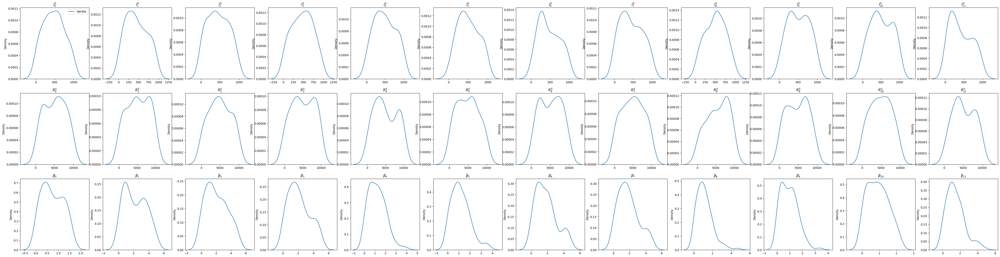

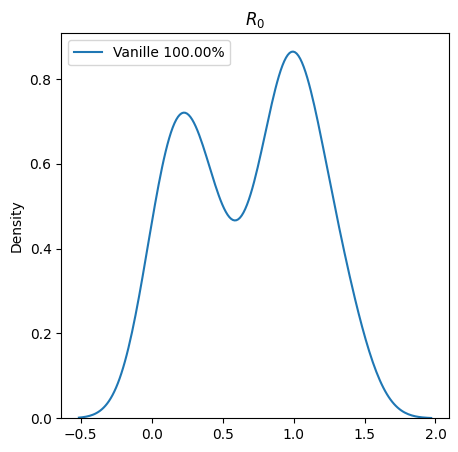

In [ ]:
display(mod_reg,[thetas_van_reg],["Vanille"])

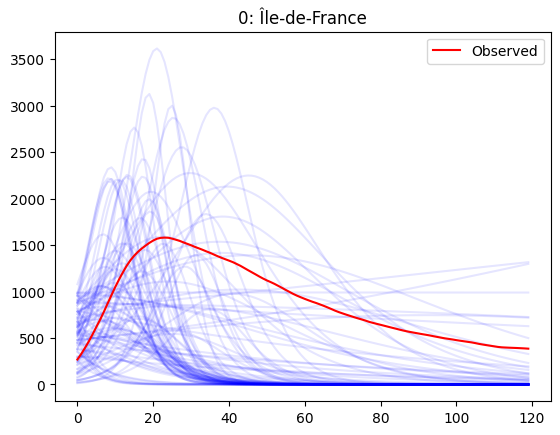

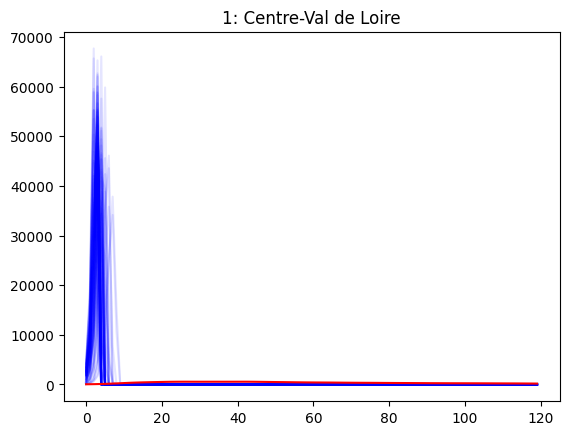

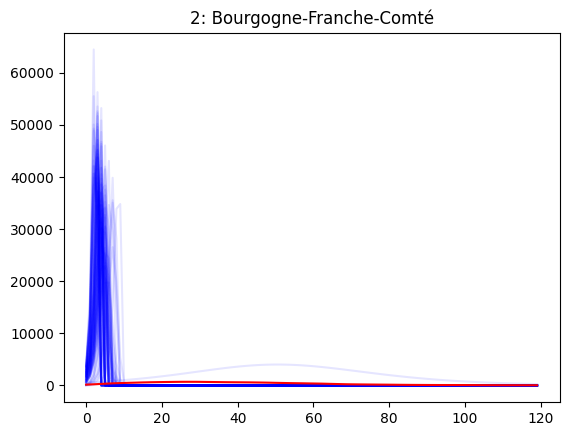

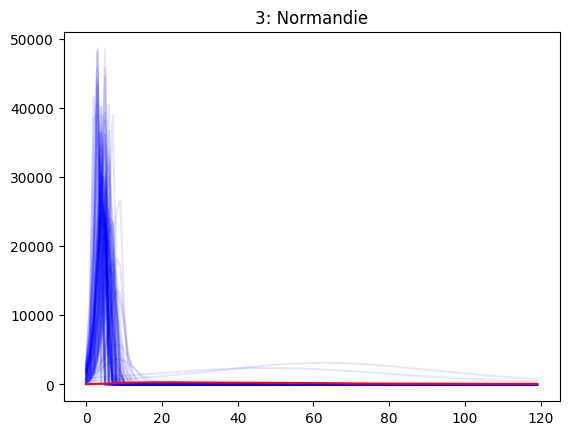

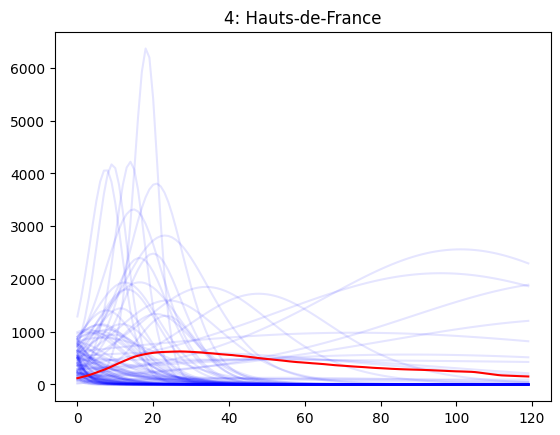

...

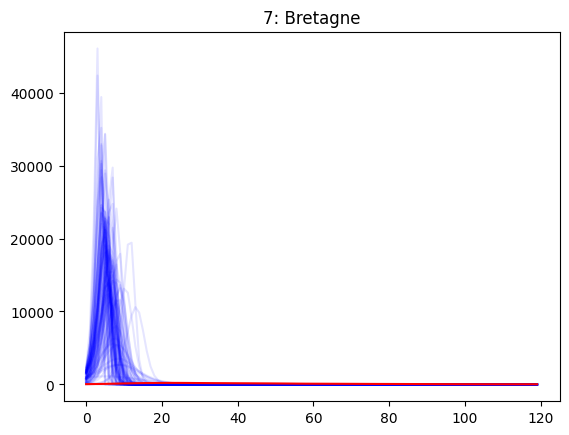

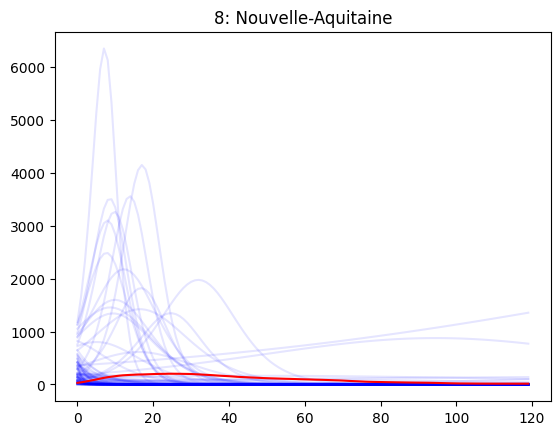

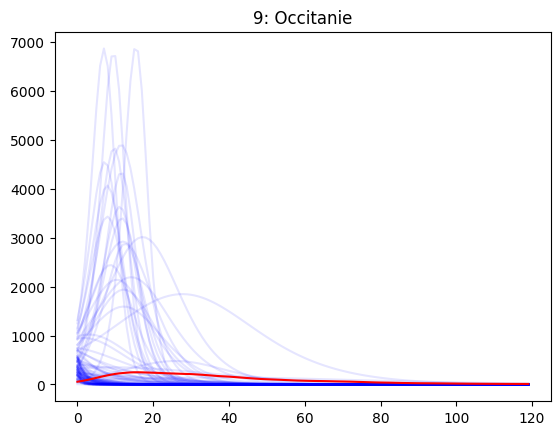

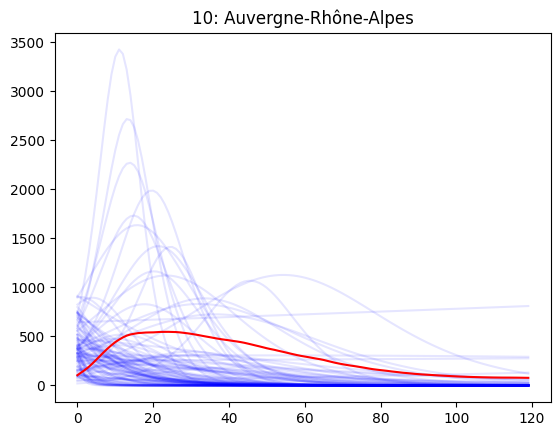

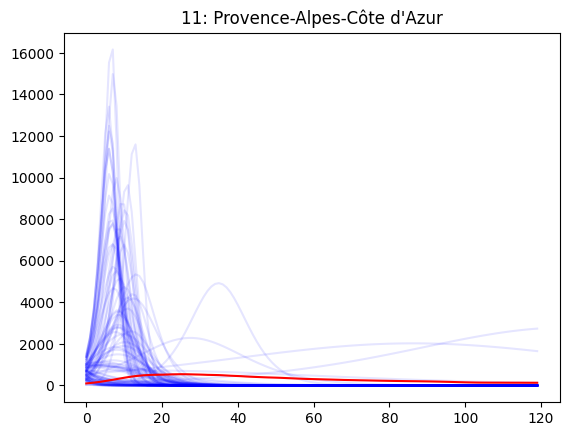

In [ ]:
key, key_fit = random.split(key)
fit_data(mod_reg, key_fit, y_obs_reg[0], thetas_perm_van_reg, [reg_name[r] for r in reg_list], size = 100)

#### SMC

In [ ]:
key = random.PRNGKey(0)
N = 10000
smc_reg= perm_abc_smc(key = key, model = mod_reg, y_obs = y_obs_reg, n_particles= N, kernel = KernelTruncatedRW, verbose = 1, epsilon_target = 0., update_weights_distance= False)

False
Iteration 0: Epsilon = inf, ESS = 10000 Acc. rate = 100% Numb. unique particles = 10000
Iteration 2: Espilon = 25258.1295, ESS = 9500 Acc. rate = 46.11% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%

Iteration 3: Espilon = 23837.6623, ESS = 9025 Acc. rate = 46.19% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%

Iteration 4: Espilon = 22826.2376, ESS = 8573 Acc. rate = 44.52% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%

Iteration 5: Espilon = 21973.1566, ESS = 8144 Acc. rate = 42.62% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%

Iteration 6: Espilon = 21207.2142, ESS = 7736 Acc. rate = 40.38% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0% Global parameters uniqueness rate = 100.0%

I

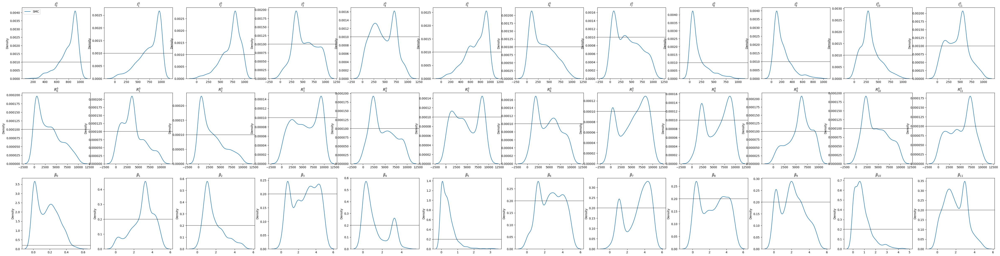

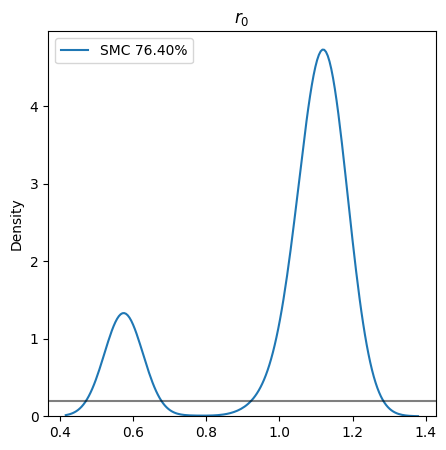

In [ ]:
display(mod_reg,[thetas_smc_reg],["SMC"], prior = True )

#### Over-Sampling

In [ ]:
os_reg = permabc_smc_os(gen, mod_reg,1000, epsilon, .7, y_obs_reg, Kernel_trunc_RW, Final_iteration = 10, H = 0, M_0 = 200)
thetas_os_reg = os_reg["Thetas"][-1]

Iteration 0: M = 200, ESS = 95 Acc. rate = 100% Numb. unique particles = 1000
Resampling... 95 unique particles left
Iteration 1: M = 143, ESS = 853 Acc. rate = 5.74% Uniqueness rate particules = 14.4% Uniqueness rate components = 14.4%
Glob unique: 14.40%
Iteration 2: M = 103, ESS = 712 Acc. rate = 6.74% Uniqueness rate particules = 18.6% Uniqueness rate components = 18.6%
Glob unique: 18.60%
Iteration 3: M = 75, ESS = 628 Acc. rate = 7.80% Uniqueness rate particules = 22.6% Uniqueness rate components = 22.6%
Glob unique: 22.60%
Iteration 4: M = 56, ESS = 505 Acc. rate = 6.14% Uniqueness rate particules = 24.6% Uniqueness rate components = 24.6%
Glob unique: 24.60%
Resampling... 175 unique particles left
Iteration 5: M = 42, ESS = 1000 Acc. rate = 10.40% Uniqueness rate particules = 27.9% Uniqueness rate components = 27.9%
Glob unique: 27.90%
Iteration 6: M = 33, ESS = 786 Acc. rate = 9.54% Uniqueness rate particules = 33.8% Uniqueness rate components = 33.8%
Glob unique: 33.80%
Itera

#### Under-Matching


In [ ]:
um_reg = permabc_smc_um(gen, mod_reg, 1000, epsilon, .9, y_obs_reg, Kernel_trunc_RW, Final_iteration = 100, H = 0, L_0 = 1,alpha_resample = .5)
thetas_um_reg = um_reg["Thetas"][-1]

Iteration 0: L = 1, ESS = 525 Acc. rate = 100% Numb. unique particles = 1000
Resampling... 348 unique particles left
Silo 11: 0.00% matched!
Silo 4: 0.60% matched!
Silo 6: 0.90% matched!
Silo 3: 1.10% matched!
Silo 5: 1.10% matched!

Iteration 1: L = 2, ESS = 1000 Acc. rate = 55.40% Uniqueness rate particules = 82.6% Uniqueness rate components = 82.6%
Glob unique: 82.60%
Silo 11: 0.00% matched!
Silo 4: 0.60% matched!
Silo 3: 0.90% matched!
Silo 5: 0.90% matched!
Silo 6: 1.10% matched!

Iteration 2: L = 3, ESS = 850 Acc. rate = 60.24% Uniqueness rate particules = 91.2% Uniqueness rate components = 91.2%
Glob unique: 91.20%
Silo 11: 0.00% matched!
Silo 4: 0.60% matched!
Silo 5: 1.50% matched!
Silo 6: 2.60% matched!
Silo 3: 4.40% matched!

Iteration 3: L = 4, ESS = 802 Acc. rate = 56.86% Uniqueness rate particules = 93.5% Uniqueness rate components = 93.5%
Glob unique: 93.50%
Silo 11: 0.00% matched!
Silo 5: 2.60% matched!
Silo 4: 3.80% matched!
Silo 6: 4.80% matched!
Silo 10: 6.50% matche

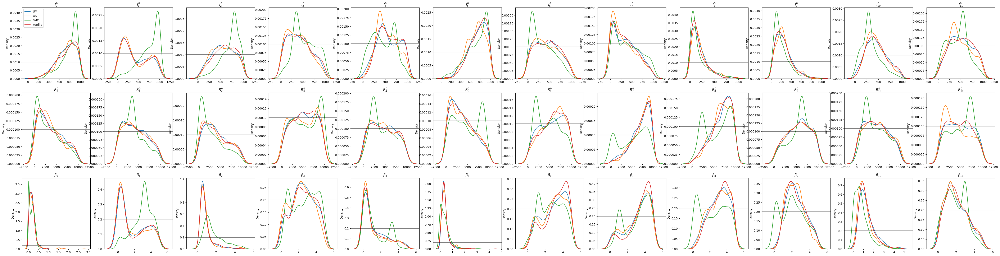

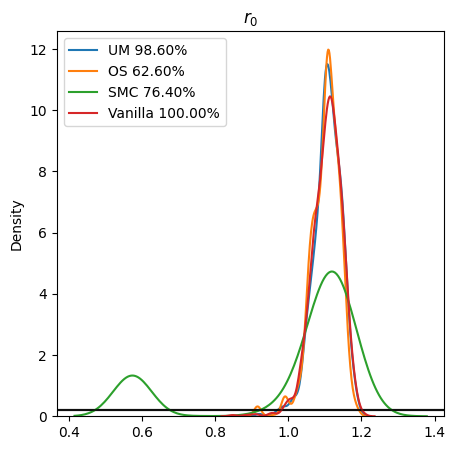

In [ ]:
display(mod_reg,[thetas_um_reg,thetas_os_reg,thetas_smc_reg, thetas_abc_reg],["UM","OS","SMC","Vanilla"], prior = True)

Weight population??? Normalization?

### Fitting at the lowest $\epsilon$

In [ ]:
smc_reg_fit = permabc_smc(gen, mod_reg,1000, 12, .95, I_obs_reg_V1[np.newaxis,:],Kernel_trunc_RW, verbose = 1, Final_iteration = 300, H = 6)

Iteration 0: Epsilon = inf, ESS = 1000 Acc. rate = 100% Numb. unique particles = 1000
Iteration 2: Espilon = 763.44, ESS = 950 Acc. rate = 94.95% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 3: Espilon = 733.43, ESS = 902 Acc. rate = 94.90% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 4: Espilon = 702.95, ESS = 856 Acc. rate = 93.22% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 5: Espilon = 682.25, ESS = 813 Acc. rate = 93.36% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 6: Espilon = 659.07, ESS = 772 Acc. rate = 92.23% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 7: Espilon = 632.51, ESS = 733 Acc. rate = 93.59% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.

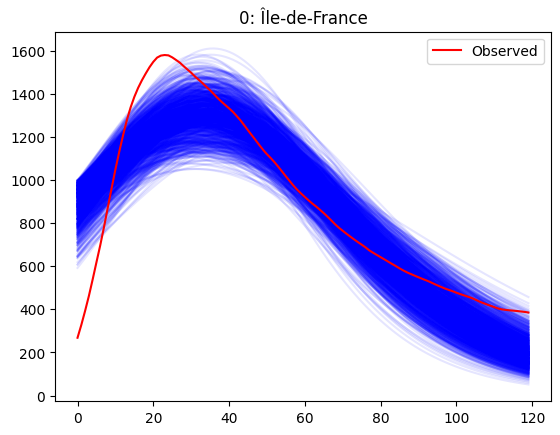

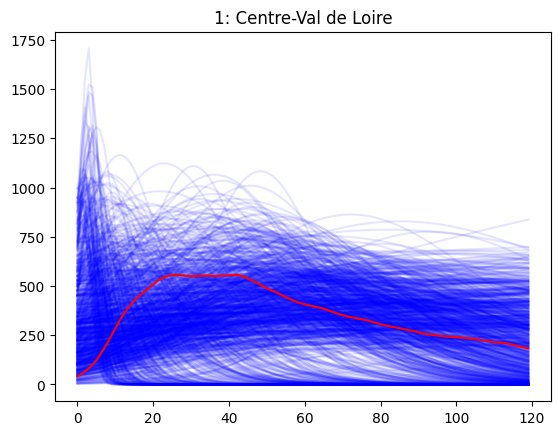

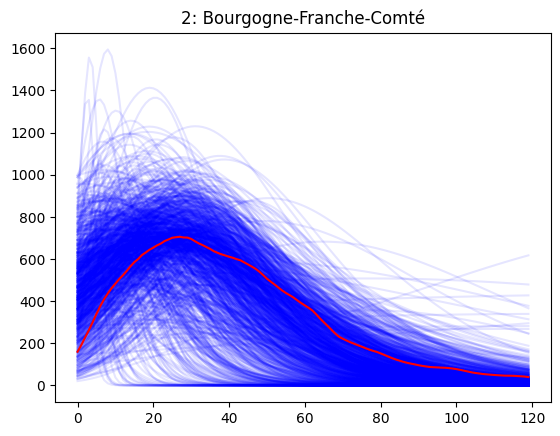

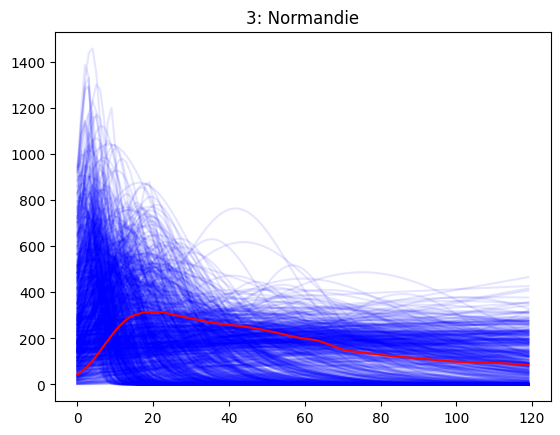

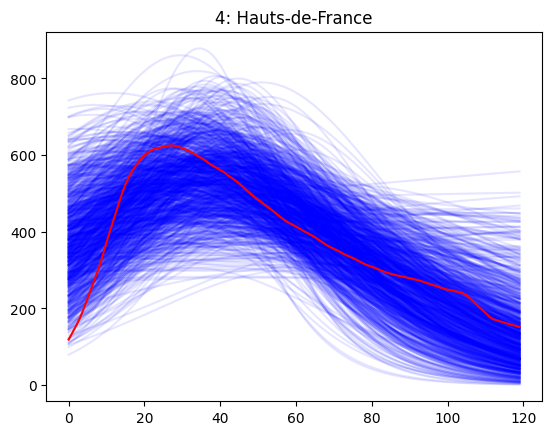

...

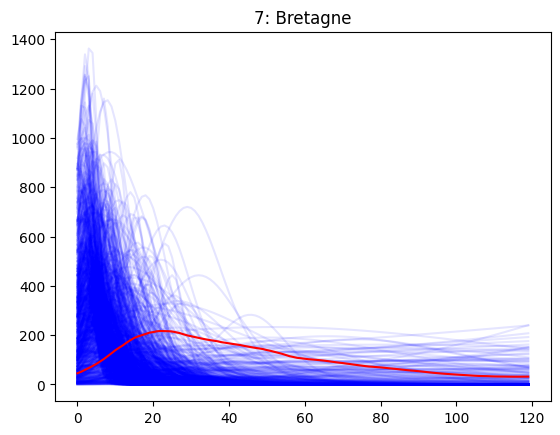

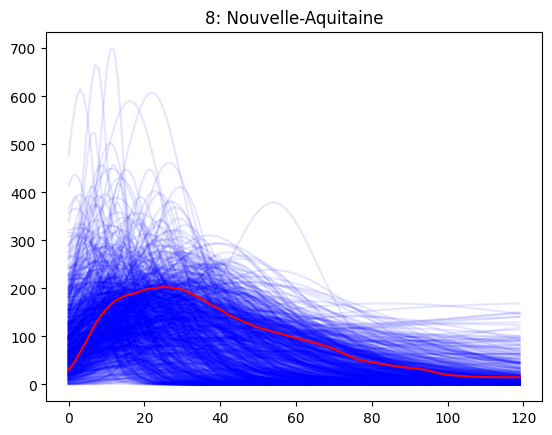

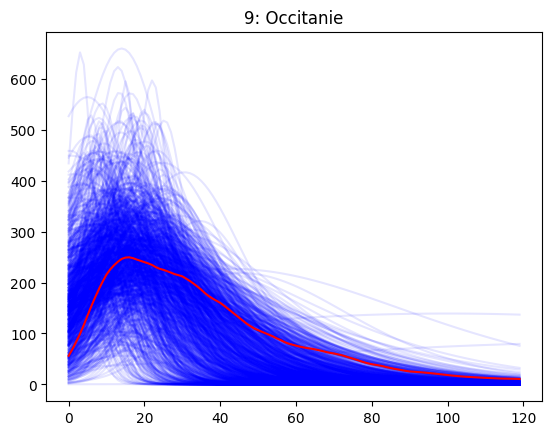

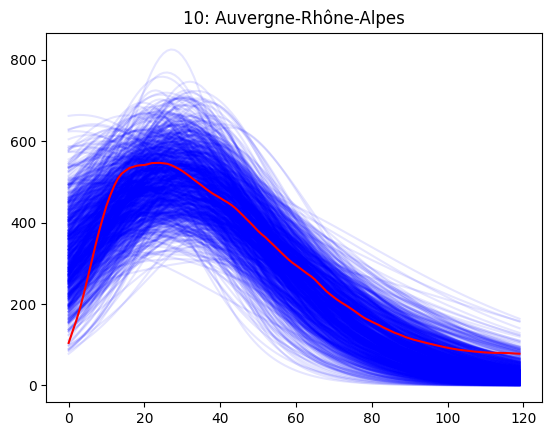

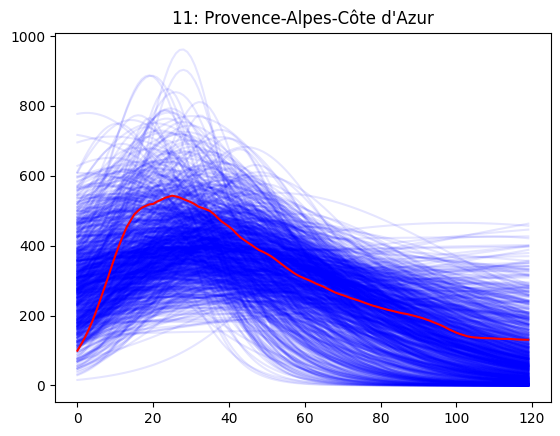

In [ ]:
fit_data(mod_reg, gen, y_obs_reg[0], smc_reg_fit["Thetas"][-1], [reg_name[r] for r in reg_list], size = 1000)

In [ ]:
os_reg_fit = permabc_smc_os(gen, mod_reg,1000, 100, .7, y_obs_reg, Kernel_trunc_RW, Final_iteration = 300, H = 9, M_0 = 200)

Iteration 0: M = 200, ESS = 342 Acc. rate = 100% Numb. unique particles = 1000
Resampling... 342 unique particles left
Iteration 1: M = 143, ESS = 991 Acc. rate = 87.49% Uniqueness rate particules = 98.2% Uniqueness rate components = 77.6%
Glob unique: 69.90%
Iteration 2: M = 103, ESS = 977 Acc. rate = 87.00% Uniqueness rate particules = 99.3% Uniqueness rate components = 92.8%
Glob unique: 85.10%
Iteration 3: M = 75, ESS = 971 Acc. rate = 87.85% Uniqueness rate particules = 99.4% Uniqueness rate components = 96.9%
Glob unique: 93.30%
Iteration 4: M = 56, ESS = 964 Acc. rate = 87.24% Uniqueness rate particules = 99.4% Uniqueness rate components = 98.6%
Glob unique: 96.30%
Iteration 5: M = 42, ESS = 955 Acc. rate = 85.76% Uniqueness rate particules = 99.4% Uniqueness rate components = 99.2%
Glob unique: 97.90%
Iteration 6: M = 33, ESS = 951 Acc. rate = 84.96% Uniqueness rate particules = 99.4% Uniqueness rate components = 99.2%
Glob unique: 98.10%
Iteration 7: M = 26, ESS = 943 Acc. rat

In [ ]:
um_reg_fit = permabc_smc_um(gen, mod_reg,1000, 100, .7, y_obs_reg, Kernel_trunc_RW, Final_iteration = 300, H = 9, L_0 = 1)

Iteration 0: L = 1, ESS = 1000 Acc. rate = 100% Numb. unique particles = 1000
Resampling... 484 unique particles left
Silo 6: 0.40% matched!
Silo 4: 0.80% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 8.90% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 8.70% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 8.60% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 8.60% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 8.20% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 8.00% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% matched!
Silo 7: 2.50% matched!
Silo 3: 7.80% matched!

Silo 6: 0.40% matched!
Silo 4: 0.90% matched!
Silo 11: 1.00% ma

## At the departmental scale

### With independant Vanilla

In [ ]:
T=100000
abcp=[]
gen = np.random.default_rng()
mod_i = model_SIR(1, n, 100000, high_I = 1000, high_R = 10000, high_beta = 5, high_r0=5)
for i in tqdm(range(I_obs_dep_V1.shape[0])): 
    y_obs_i = I_obs_dep_V1[i][np.newaxis,np.newaxis,:]
    abc_i = ABC_table(gen, mod_i, y_obs_i, T, 1, 1, perm = False)
    abcp.append(abc_i)


  0%|          | 0/94 [00:00<?, ?it/s]

NameError: name 'ABC_table' is not defined

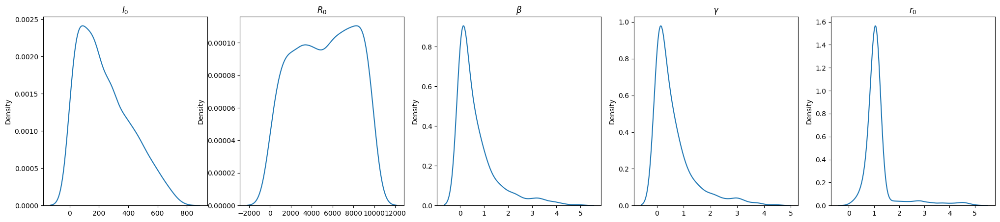

0: I_0 = 240.0239535004298 R_0 = 5210.411883295897 Beta = 0.6712884559868928 Gamma = 0.6181884433266185 R0 = 1.1989069340138985 Epsilon = 19.881903268757494


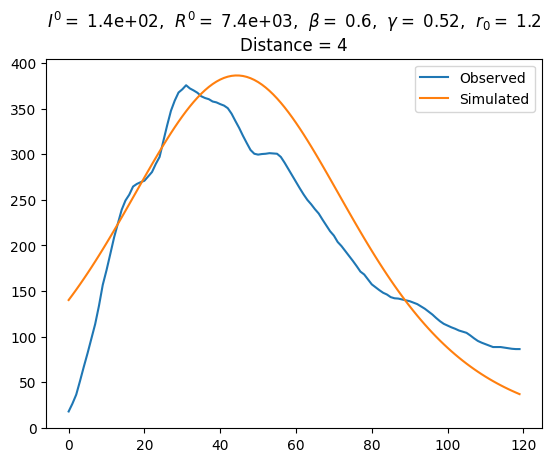

Epsilon =  19.881903268757494 Distance =  [4.31862449] [4.31862449]
6.126868412803057


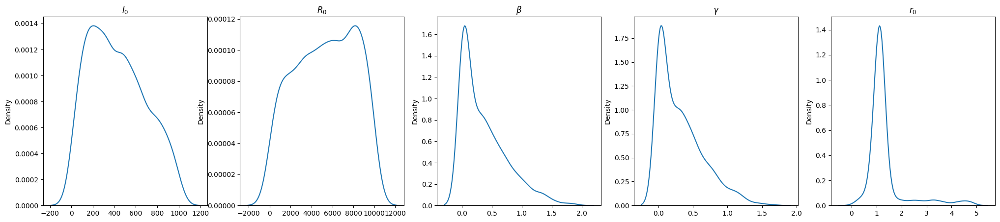

1: I_0 = 426.7195995240173 R_0 = 5312.4704388502405 Beta = 0.3682995986953392 Gamma = 0.321623111197436 R0 = 1.3404007048332434 Epsilon = 37.35255300209851


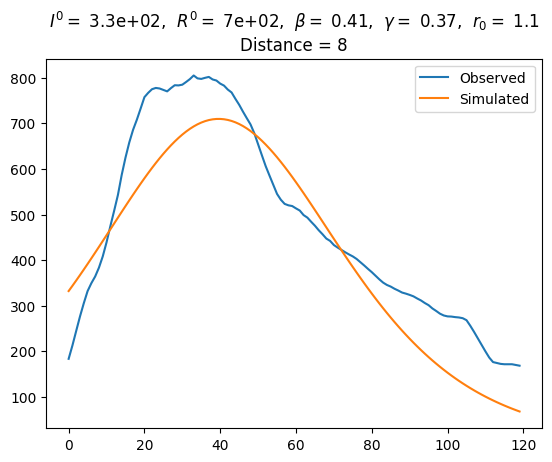

Epsilon =  37.35255300209851 Distance =  [8.42835765] [8.42835765]
4.448451895990173


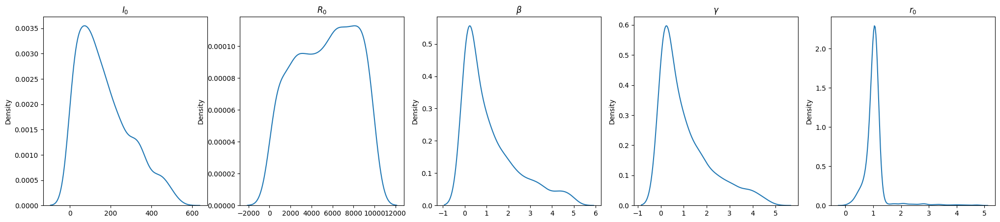

2: I_0 = 167.88200680011238 R_0 = 5320.355680582092 Beta = 1.1500367906888547 Gamma = 1.0779936832768713 R0 = 1.0563912254498986 Epsilon = 12.031066700480437


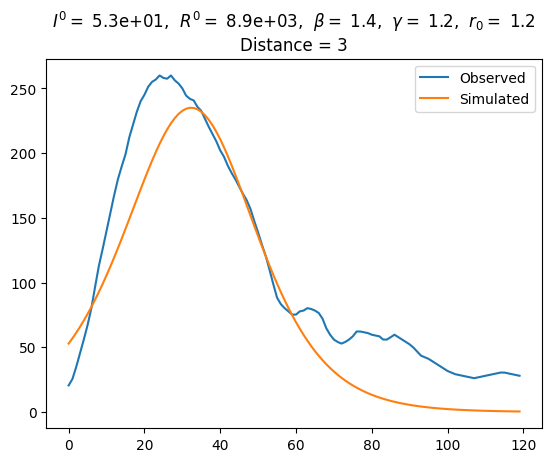

Epsilon =  12.031066700480437 Distance =  [3.07149242] [3.07149242]
11.34294852902978


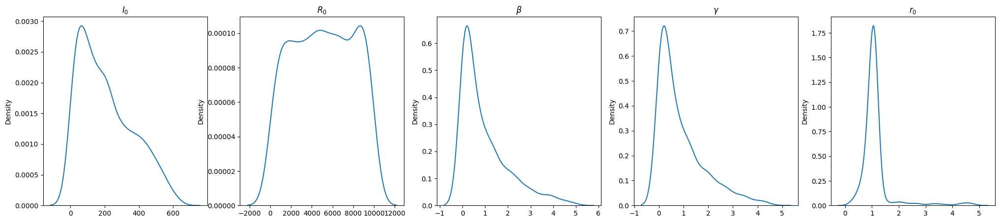

3: I_0 = 208.8146565727815 R_0 = 5113.875118186154 Beta = 0.9572541631726031 Gamma = 0.8847936786990807 R0 = 1.1346747201114313 Epsilon = 14.387017949892826


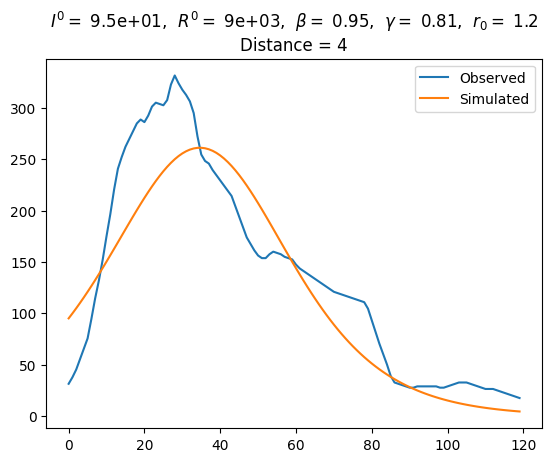

Epsilon =  14.387017949892826 Distance =  [3.67789889] [3.67789889]
10.374997588796308


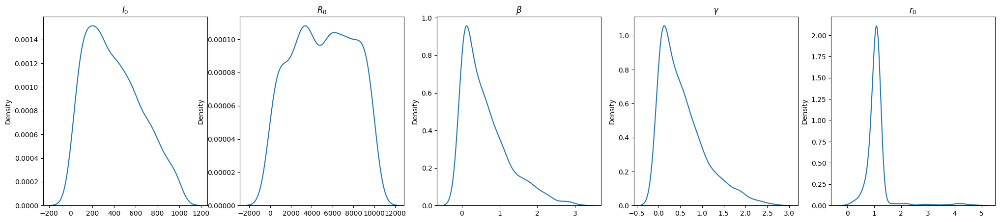

4: I_0 = 401.23434388101583 R_0 = 5078.147735926593 Beta = 0.6220902603166574 Gamma = 0.5602851734964952 R0 = 1.1140982403696067 Epsilon = 22.794805476362814


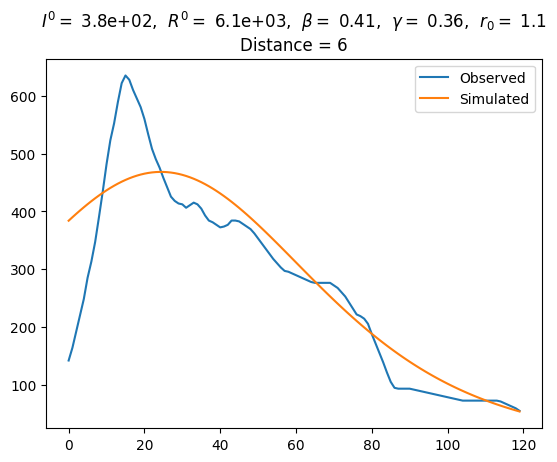

Epsilon =  22.794805476362814 Distance =  [6.14383336] [6.14383336]
7.217224696303271


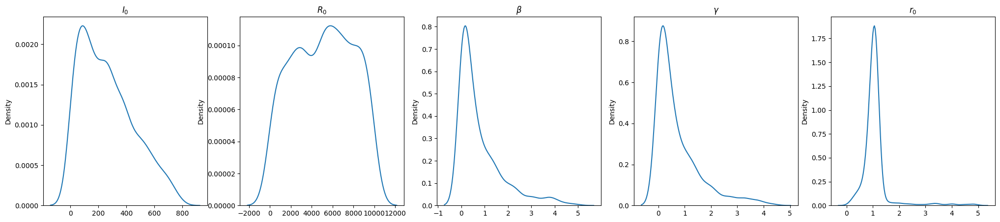

5: I_0 = 263.2867624853149 R_0 = 5103.799745482258 Beta = 0.7847618885950459 Gamma = 0.7238425072481817 R0 = 1.0940391057404244 Epsilon = 18.24373133848226


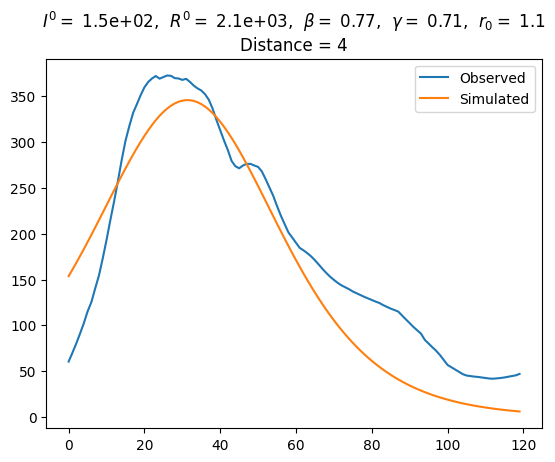

Epsilon =  18.24373133848226 Distance =  [4.13611144] [4.13611144]
7.078954069487208


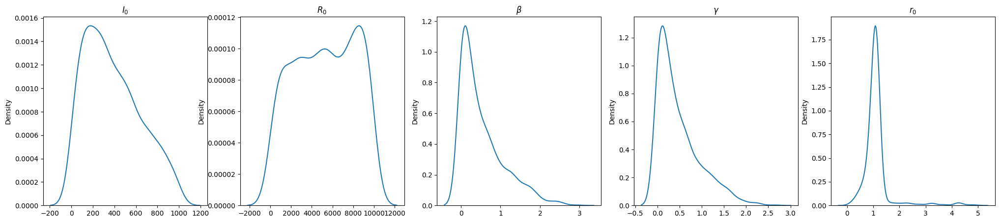

6: I_0 = 384.5383584450968 R_0 = 5250.016081592789 Beta = 0.5277838137678359 Gamma = 0.4770459968697014 R0 = 1.1272164324478469 Epsilon = 27.355049886478596


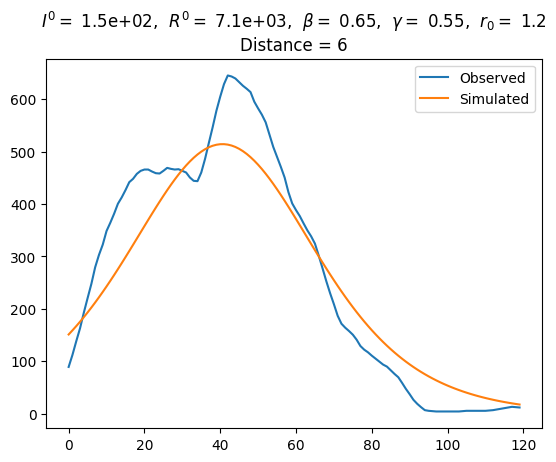

Epsilon =  27.355049886478596 Distance =  [6.11510416] [6.11510416]
7.207794048356133


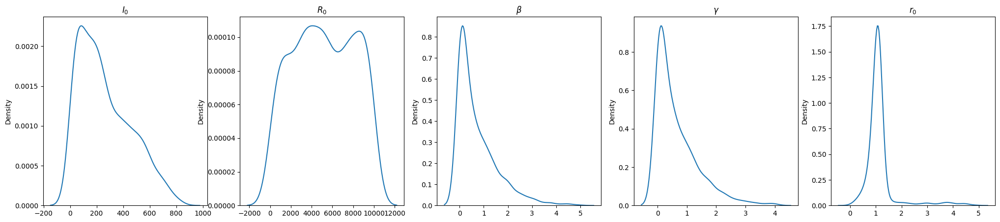

7: I_0 = 263.3615404008428 R_0 = 5173.213271782737 Beta = 0.72277452099597 Gamma = 0.6567148255121622 R0 = 1.1545581780277792 Epsilon = 20.20548219720143


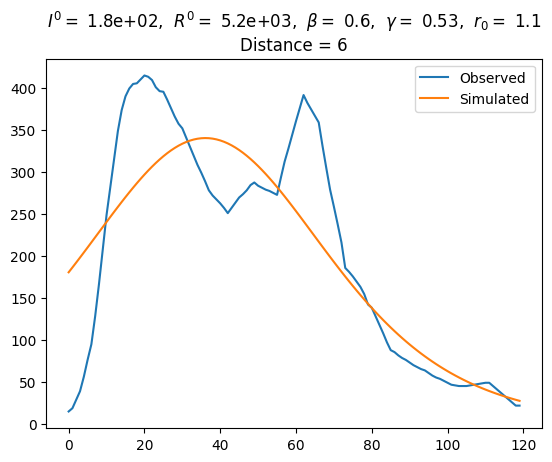

Epsilon =  20.20548219720143 Distance =  [6.42565598] [6.42565598]
13.858286255453509


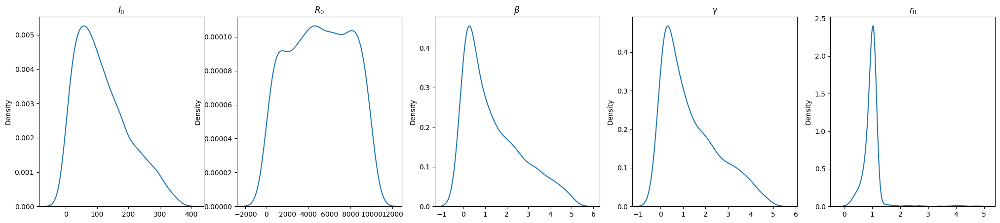

8: I_0 = 117.08384561197629 R_0 = 5063.081884342617 Beta = 1.3810765895340515 Gamma = 1.3444819403075967 R0 = 0.984626597891661 Epsilon = 6.823842785093333


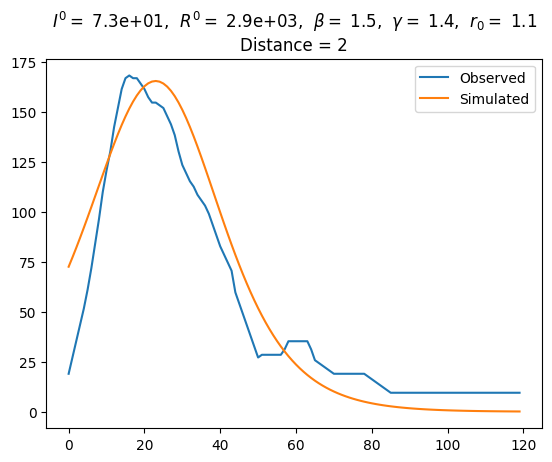

Epsilon =  6.823842785093333 Distance =  [1.54203591] [1.54203591]
11.801171333458072


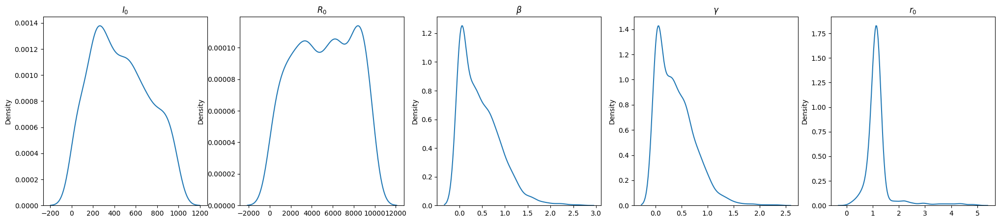

9: I_0 = 456.8289508441681 R_0 = 5166.673992380047 Beta = 0.4574426814570845 Gamma = 0.3928267358062543 R0 = 1.2191549884683066 Epsilon = 44.4359074107845


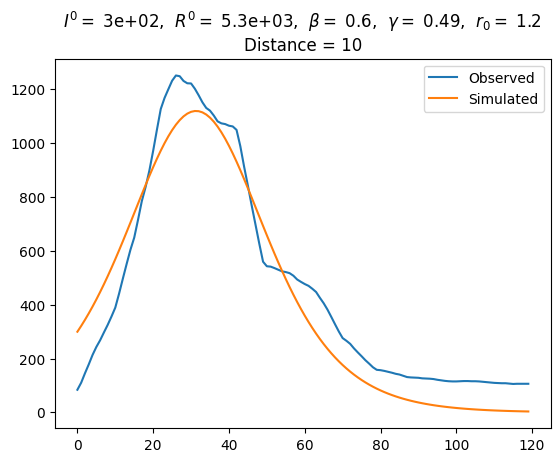

Epsilon =  44.4359074107845 Distance =  [10.15801542] [10.15801542]
6.716203990645207


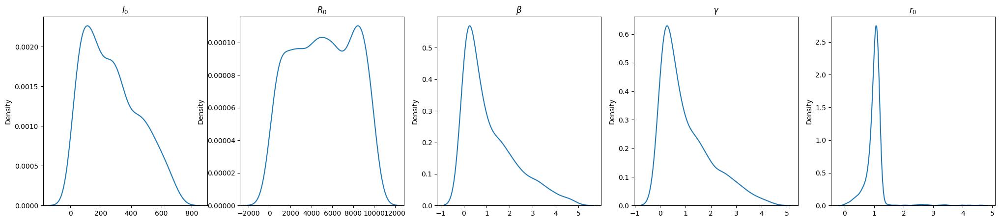

10: I_0 = 271.69210416916945 R_0 = 5162.432455336713 Beta = 1.1193823962584337 Gamma = 1.032402031416425 R0 = 1.011233768410499 Epsilon = 12.525862026071913


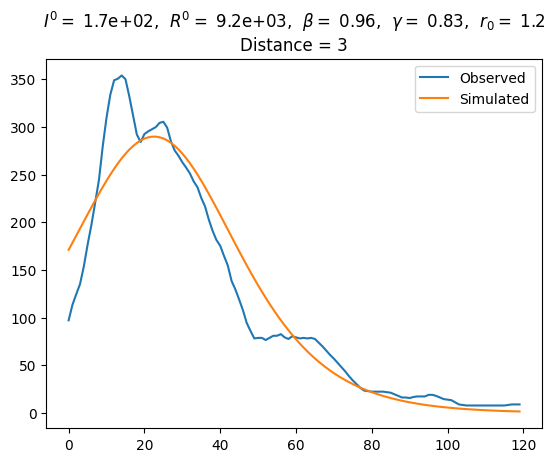

Epsilon =  12.525862026071913 Distance =  [2.81002694] [2.81002694]
8.466780045246654


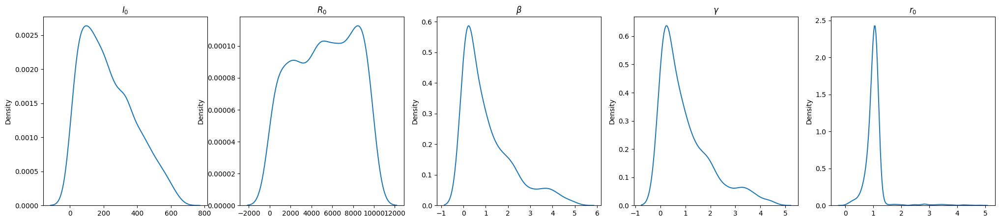

11: I_0 = 228.27543477797377 R_0 = 5204.995091878932 Beta = 1.0743181075253356 Gamma = 0.9984139073074028 R0 = 1.041350640930115 Epsilon = 12.831144029952618


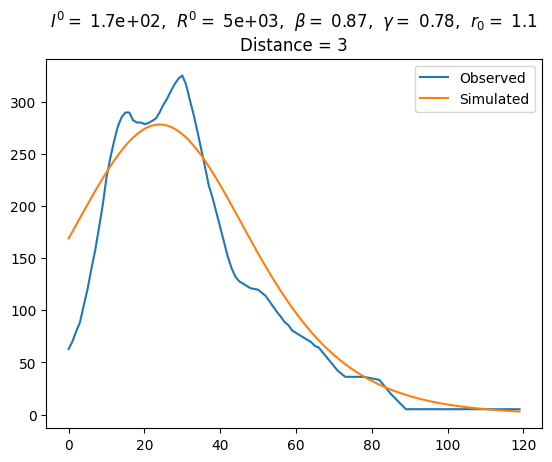

Epsilon =  12.831144029952618 Distance =  [2.98170643] [2.98170643]
10.386790476367032


In [ ]:
Beta,Gamma = [],[]
Epsilon = []

for i in range(I_obs_reg_V1.shape[0]):
    
    distances = abcp[i][2]
    thetas = abcp[i][0][np.argsort(distances)[:1000]]
    distances_ok = np.sort(distances)[:1000]
    epsilon = np.sort(distances)[1000]
    Epsilon.append(epsilon)
    
    I0s = thetas.loc[:,0,0].reshape(-1)
    R0s = thetas.loc[:,0,1].reshape(-1)
    betas = thetas.loc[:,0,2].reshape(-1)
    r0s = thetas.glob[:,0].reshape(-1)
    gammas = betas/r0s

    f,ax = plt.subplots(1,5,figsize=(25,5))
    sns.kdeplot(I0s,ax=ax[0])
    ax[0].set_title("$I_0$")
    sns.kdeplot(R0s,ax=ax[1])
    ax[1].set_title("$R_0$")
    sns.kdeplot(betas,ax=ax[2])
    ax[2].set_title("$\\beta$")
    sns.kdeplot(gammas,ax=ax[3])
    ax[3].set_title("$\gamma$")
    sns.kdeplot(r0s,ax=ax[4])
    ax[4].set_title("$r_0$")
    plt.show()
    
    distances = abcp[i][2]
    print("{}: I_0 = {} R_0 = {} Beta = {} Gamma = {} R0 = {} Epsilon = {}".format(i,I0s.mean(), R0s.mean(), betas.mean(), gammas.mean(), r0s.mean(),epsilon))
    Beta.append(betas.mean())
    Gamma.append(gammas.mean())
    index_random = [0]
    
    theta_i = Theta(loc = np.array([I0s[index_random], R0s[index_random], betas[index_random]])[np.newaxis,np.newaxis,:],glob= np.array([[r0s[index_random]]]))

    plt.plot(I_obs_dep_V1[i], label = "Observed")
    I_sim = mod_i.data_gen(gen,theta_i)
    plt.plot(I_sim[0,0], label = "Simulated")
    plt.title("$I^0 =$ {:.2},  $R^0 =$ {:.2},  $\\beta =$ {:.2},  $\gamma =$ {:.2},  $r_0 =$ {:.2}\nDistance = {:0.0f}".format(I0s[index_random][0], R0s[index_random][0], betas[index_random][0], gammas[index_random][0], r0s[index_random][0], distances_ok[index_random][0]))
    plt.legend()
    plt.show()
    obs_distance = distance_arr(I_sim, I_obs_dep_V1[i][np.newaxis,np.newaxis,:])
    print("Epsilon = ", epsilon, "Distance = ", obs_distance, distances_ok[index_random])
    zs = I_sim
    y_obs = I_obs_dep_V1[i][np.newaxis,np.newaxis,:]
    print((((zs[0]-y_obs[0])/y_obs.sum(axis=2)*y_obs.shape[2])**2).sum())

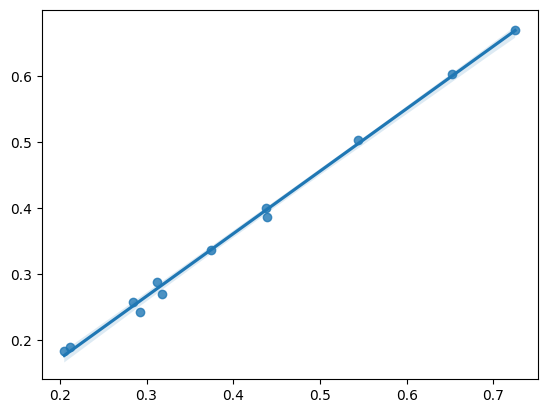

In [ ]:

sns.regplot(x = Beta, y = Gamma)
plt.show()

### Hierarchical model

In [11]:
weights_dep = [dep_pop[d] for d in dep_list]
n_pop = 100000
mod_dep = SIRWithUnknownInit(K = K_dep, n_obs = n, n_pop = n_pop, high_I = 1000, high_R = 10000, high_beta=5, high_r0= 5, weights_distance = weights_dep)
y_obs_dep = np.array(I_obs_dep_V1)[np.newaxis,:]


#### Vanille

In [ ]:
T = 1000
key = random.PRNGKey(0)
key, key_thetas, key_sim = random.split(key, 3)
thetas_van_dep = mod_dep.prior_generator(key_thetas, T)
key, key_sim = random.split(key_sim)
zs_van_dep = mod_dep.data_generator(key_sim, thetas_van_dep)
dists_van_dep = mod_dep.distance(zs_van_dep, y_obs_dep)
epsilon_dep = np.quantile(dists_van_dep, 0.01)
print("epsilon = ", epsilon_dep)

epsilon =  4549.694375415451


#### perm Vanille

In [ ]:
from jax import random
key = random.PRNGKey(0)
key, key_thetas, key_sim = random.split(key, 3)
thetas_van_dep = mod_dep.prior_generator(key_thetas, T)
key, key_sim = random.split(key_sim)
zs_van_dep = mod_dep.data_generator(key_sim, thetas_van_dep)
dists_perm_van_dep, ys_index_perm_van_dep, zs_index_perm_van_dep, _ = optimal_index_distance(mod_dep, zs_van_dep, y_obs_dep)
epsilon_perm_dep = np.quantile(dists_perm_van_dep, 0.01)
print("epsilon perm = ", epsilon_perm_dep)


epsilon perm =  1938.9563428984482


#### SMC

In [12]:
key, key_smc = random.split(key)
smc_dep = abc_smc(key_smc, mod_dep, 1000, epsilon_dep, y_obs_dep, Kernel_no_perm_RW, verbose = 3, alpha = .95, Final_iteration = 100)

NameError: name 'key' is not defined

#### permSMC

In [12]:
key = random.PRNGKey(0)
key, key_perm_smc = random.split(key)
perm_smc_dep = perm_abc_smc(key = key_perm_smc, model = mod_dep, y_obs = y_obs_dep, n_particles= 1000, kernel = KernelTruncatedRW, verbose = 3, epsilon_target = 0., update_weights_distance= False, Final_iteration = 100, num_blocks_gibbs= 10, both_loc_glob=False)

False
Performing full optimal assignment (no prior indices).
Iteration 0: Epsilon = inf, ESS = 1000 Acc. rate = 100% Numb. unique particles = 1000
a) Update Epsilon: new epsilon = 8.47e+03
b) Update weights: Old ESS = 1000 New ESS = 950 (5.00% of particles killed)
c) Resampling: No resampling
d) Move particles: Global update
Sampling 495 zs...
Computing 495 distances...
Performing full optimal assignment (no prior indices).
Kernel ratio: min = -1.52, max = 1.42, mean = 0.0509
Prior ratio: min = 0.0, max = 0.0, mean = 0.0
Accepting 423 global updates...
Global thetas accept = old thetas:  False = accept thetas: True
Global zs accept = old zs:  False = accept zs: True
Global move: acceptance rate = 85.45% (rejection because ABC : 3.23% rejection because MH : 11.31%)
Sampling 455 zs...
Local update: block 1/10
Computing 455 distances...
Performing full optimal assignment (no prior indices).
Kernel ratio: min = -7.13, max = 5.19, mean = -1.08
Prior ratio: min = 0.0, max = 0.0, mean = 0.0
A

KeyboardInterrupt: 

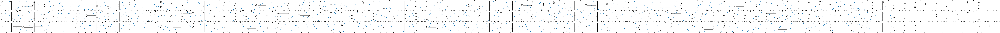

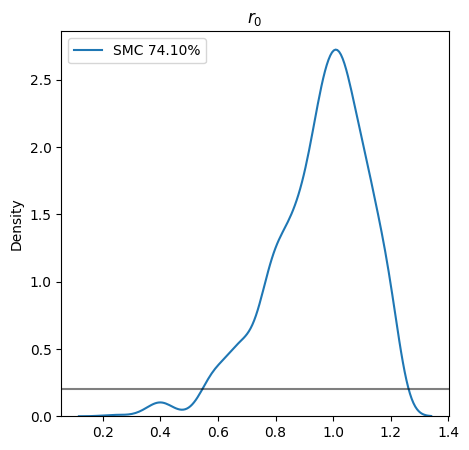

In [ ]:
display(mod_dep,[thetas_smc_dep],["SMC"], prior = True )

#### Over-Sampling

In [ ]:
os_dep = permabc_smc_os(gen, mod_dep,5000, 17, .8, y_obs_dep, Kernel_trunc_RW, Final_iteration = 50, H = 9, M_0 = 700)
thetas_os_dep = os_dep["Thetas"][-1]

#### Under-Matching


In [ ]:
um_dep = permabc_smc_um(gen, mod_dep, 1000, 12, .9, y_obs_dep, Kernel_trunc_RW, Final_iteration = 100, H = 9, L_0 = 1,alpha_resample = .5, verbose = 2)
thetas_um_dep = um_dep["Thetas"][-1]

Not smart version
Iteration 0: L = 1, ESS = 1000 Acc. rate = 100% Numb. unique particles = 1000
Rate of smart acceptation = 31.20% (312/1000) We did LSA but sigma star was optimal = 0.00% (0/688) Number of index problem = 0
New L =  10
Index killed = 63.60%
Resampling... 364 unique particles left
Rate of smart acceptation = 75.84% (383/505) We did LSA but sigma star was optimal = 0.00% (0/122) Number of index problem = 0
Rate of smart acceptation = 99.60% (493/495) We did LSA but sigma star was optimal = 0.00% (0/2) Number of index problem = 0
Rate of smart acceptation = 98.99% (490/495) We did LSA but sigma star was optimal = 0.00% (0/5) Number of index problem = 0
Rate of smart acceptation = 99.19% (491/495) We did LSA but sigma star was optimal = 0.00% (0/4) Number of index problem = 0
Rate of smart acceptation = 98.79% (489/495) We did LSA but sigma star was optimal = 0.00% (0/6) Number of index problem = 0
Rate of smart acceptation = 97.78% (484/495) We did LSA but sigma star was 

In [ ]:
K_dep

94

#### OSUM

In [ ]:
osum_dep = permabc_smc_osum(gen, mod_dep, 1000, 12,alpha_os =  .95,alpha_um = .95, y_obs= y_obs_dep, kernel = Kernel_trunc_RW, Final_iteration = 100, H = 9, L_0 = 20,M_0 = 500, alpha_resample = .5, verbose = 1)
thetas_osum_dep = osum_dep["Thetas"][-1]

Iteration 0: M = 500 L = 20, ESS = 293 Acc. rate = 100% Numb. unique particles = 1000
Silo 43: 0.00% matched!
Silo 35: 0.00% matched!
Silo 42: 0.00% matched!
Silo 33: 0.00% matched!
Silo 49: 0.00% matched!

Silo 43: 0.00% matched!
Silo 35: 0.00% matched!
Silo 33: 0.00% matched!
Silo 21: 0.00% matched!
Silo 36: 0.00% matched!

Silo 43: 0.00% matched!
Silo 35: 0.00% matched!
Silo 33: 0.00% matched!
Silo 21: 0.00% matched!
Silo 36: 0.00% matched!

Silo 42: 0.00% matched!
Silo 33: 0.00% matched!
Silo 36: 0.00% matched!
Silo 43: 0.00% matched!
Silo 21: 0.00% matched!

Silo 42: 0.00% matched!
Silo 33: 0.00% matched!
Silo 36: 0.00% matched!
Silo 43: 0.00% matched!
Silo 21: 0.00% matched!

Silo 42: 0.00% matched!
Silo 33: 0.00% matched!
Silo 36: 0.00% matched!
Silo 43: 0.00% matched!
Silo 21: 0.00% matched!

Silo 42: 0.00% matched!
Silo 33: 0.00% matched!
Silo 36: 0.00% matched!
Silo 43: 0.00% matched!
Silo 21: 0.00% matched!

Silo 42: 0.00% matched!
Silo 33: 0.00% matched!
Silo 36: 0.00% matc

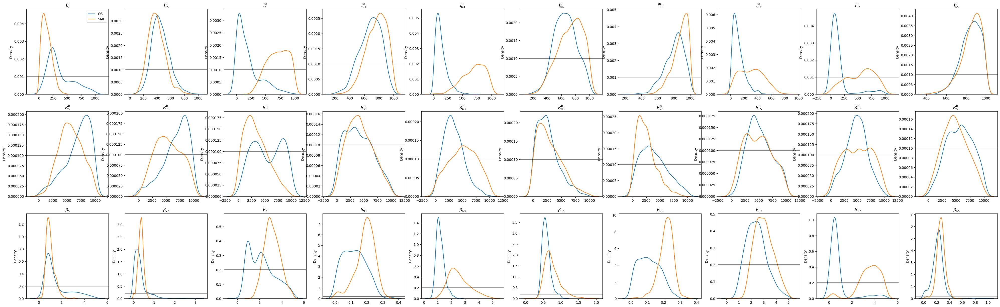

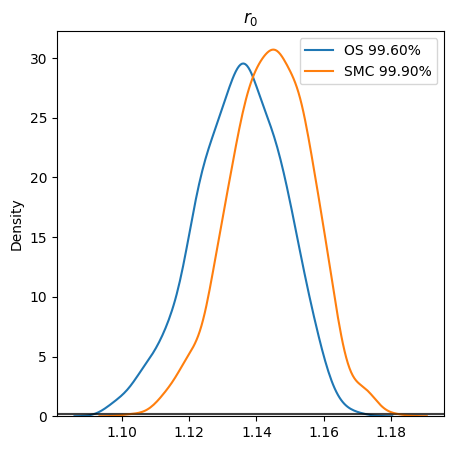

In [ ]:
display(mod_dep,[thetas_os_dep,thetas_smc_dep],["OS","SMC"], prior = True, K_prime = 10)

Weight population??? Normalization?

### Fitting at the lowest $\epsilon$

In [ ]:
smc_dep_fit = permabc_smc(gen, mod_dep,1000, 12, .95, y_obs_dep,Kernel_trunc_RW, H=9, verbose = 1, Final_iteration = 300)

Iteration 0: Epsilon = inf, ESS = 1000 Acc. rate = 100% Numb. unique particles = 1000
Iteration 2: Espilon = 683.38, ESS = 950 Acc. rate = 95.47% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 3: Espilon = 665.45, ESS = 902 Acc. rate = 94.46% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 4: Espilon = 648.09, ESS = 856 Acc. rate = 94.28% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 5: Espilon = 629.19, ESS = 813 Acc. rate = 91.88% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 6: Espilon = 611.41, ESS = 772 Acc. rate = 91.58% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.00%
Iteration 7: Espilon = 588.74, ESS = 733 Acc. rate = 91.68% Uniqueness rate particules = 100.0% Uniqueness rate components = 100.0%
Glob unique: 100.

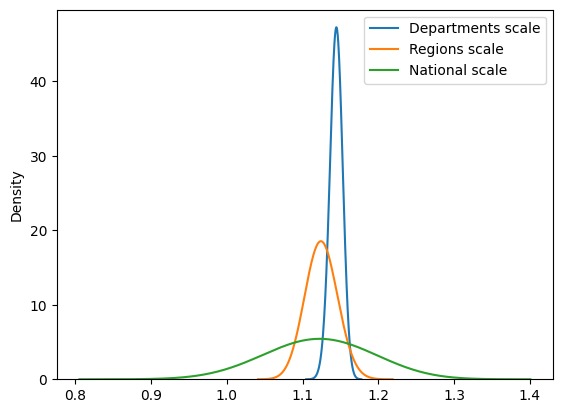

: 

In [ ]:
sns.kdeplot(smc_dep_fit["Thetas"][-1].glob[:,0], label = "Departments scale", bw_method = 1)
sns.kdeplot(smc_reg_fit["Thetas"][-1].glob[:,0], label = "Regions scale", bw_method = 1)
sns.kdeplot(smc_fr["Thetas"][-1].glob[:,0], label = "National scale", bw_method = 1)
plt.legend()
plt.show()

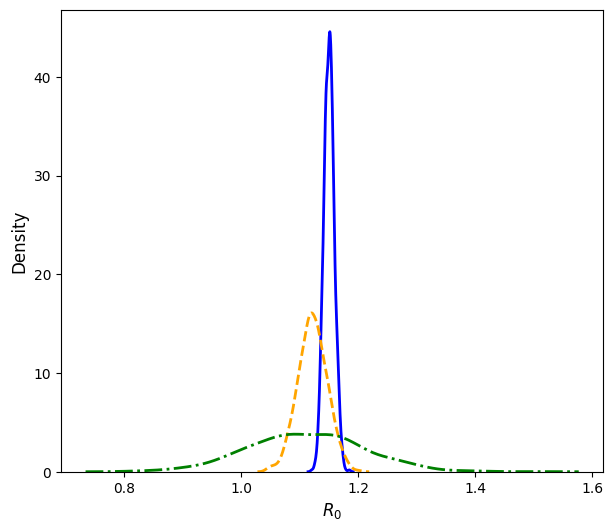

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Generating sample data
np.random.seed(42)
data1 = np.random.normal(1.15, 0.009, 1000)
data2 = np.random.normal(1.12, 0.025, 1000)
data3 = np.random.normal(1.11, 0.1, 1000)

# Creating the plot
plt.figure(figsize=(7,6))

sns.kdeplot(data1, label='Departments scale', linewidth=2, linestyle='-', color='blue')
sns.kdeplot(data2, label='Regions scale', linewidth=2, color='orange', linestyle='--')
sns.kdeplot(data3, label='National scale', linewidth=2, color='green', linestyle='-.')

# Adding labels and title
plt.xlabel('$R_0$', fontsize=12)
plt.ylabel('Density', fontsize=12)


# Adding legend
# plt.legend()

# Display the plo
plt.savefig("SIR_R0_posterior.pdf")
plt.show()


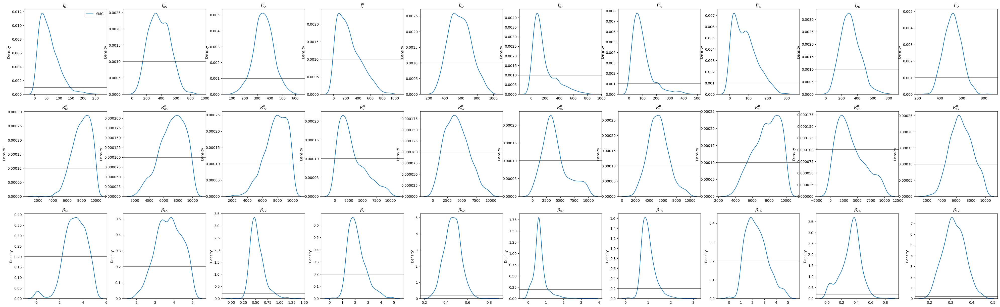

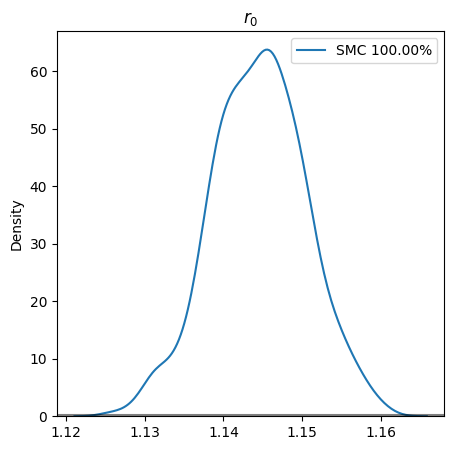

In [ ]:
display(mod_dep,[smc_dep_fit["Thetas"][-1]],["SMC"], prior = True, K_prime = 10)

In [ ]:
dep_name

NameError: name 'dep_name' is not defined

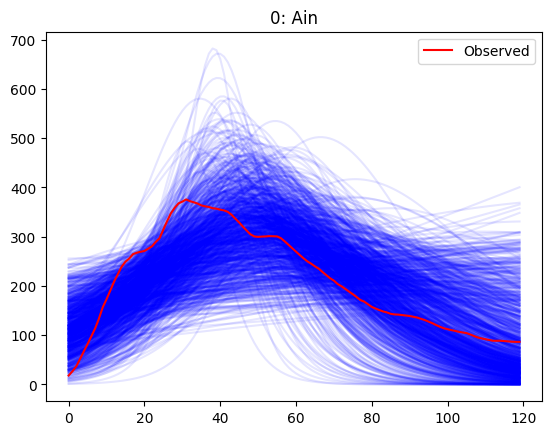

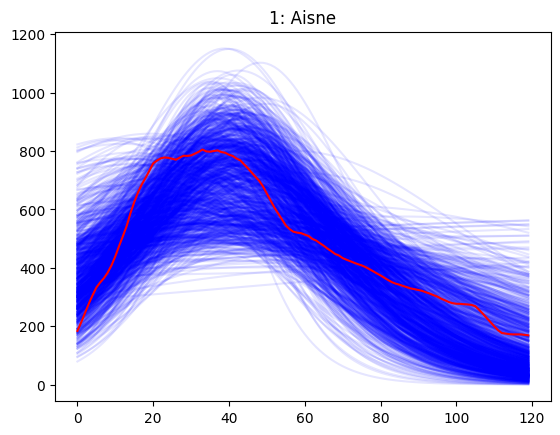

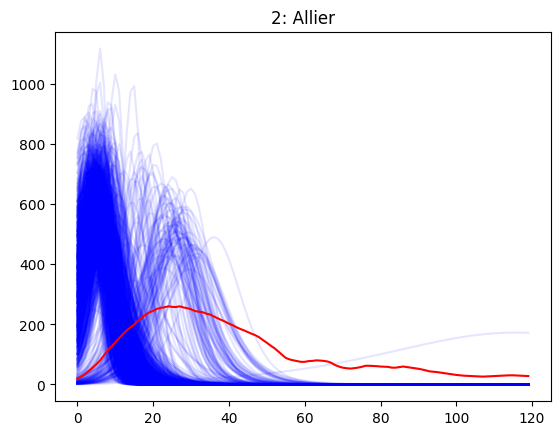

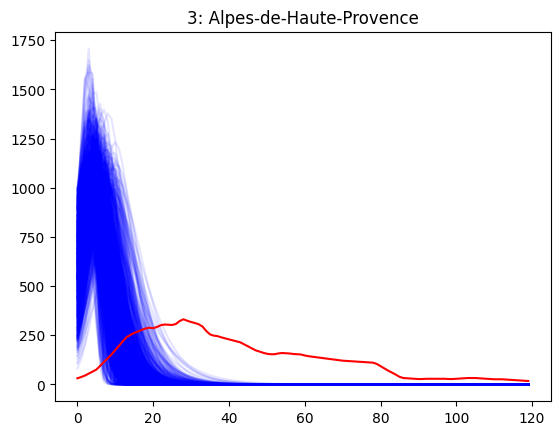

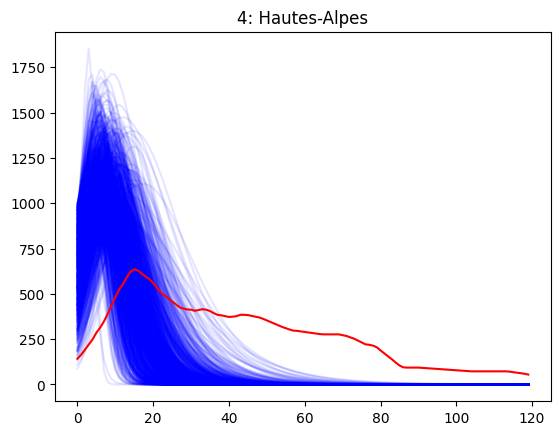

...

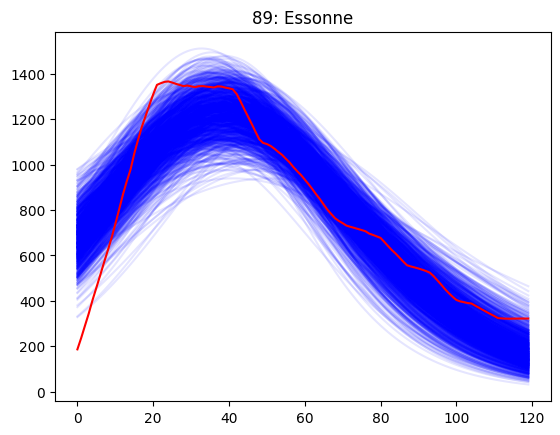

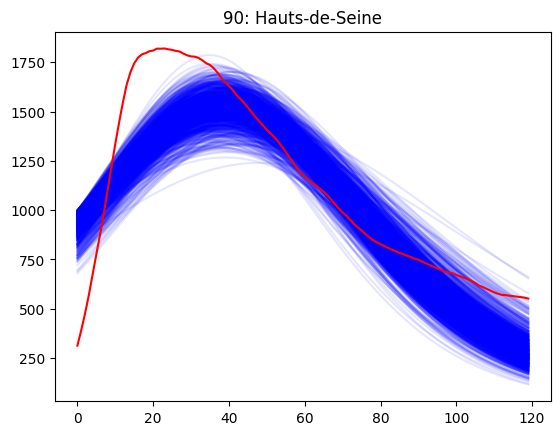

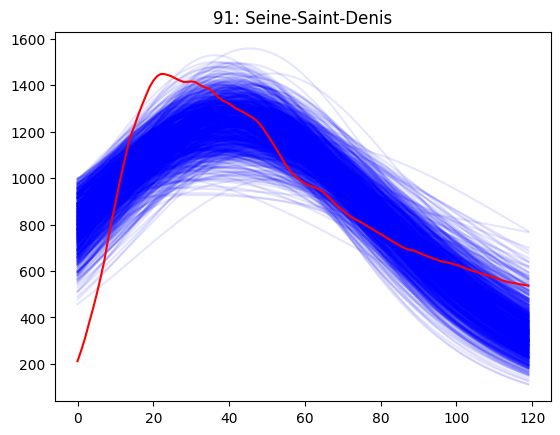

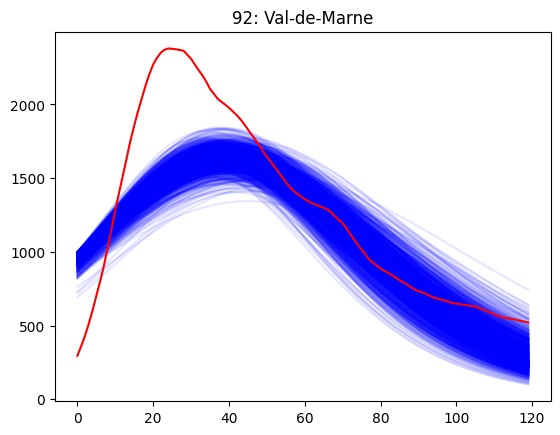

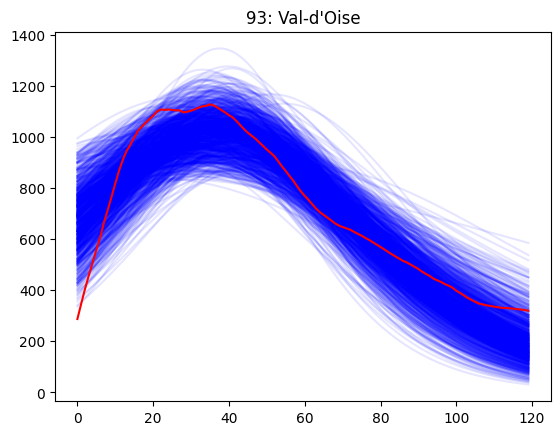

In [ ]:
fit_data(mod_dep, gen, I_obs_dep_V1, smc_dep_fit["Thetas"][-1], [dep_name[d] for d in dep_list], size = 1000)